# Problem 1 — Frequency Translation & Selective Mixing

In this problem I used a classic frequency-domain trick: translate one signal in frequency so it **moves out of the audible baseband**, mix it with a second signal, and then use an **inverse translation** to selectively reveal either source.

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from IPython.display import Audio, display

## 1) I/O helpers and plotting utilities


**What I implemented:** robust audio I/O + small helpers.

* `read_wav_safe` and `write_wav_safe` read/write WAV using `soundfile` and fall back to `scipy`. I convert to **mono float32** and, if needed, **resample** so both signals share one `sr` (44100 Hz).
* `normalize_audio` peak-normalizes to avoid clipping when mixing.
* `ensure_same_length` trims both arrays to the same length.
* `plot_waveform` and `plot_spectrum` visualize time signals and their spectra (I zero-pad to a power of two before `rfft` for a clean frequency grid).

**Why this matters:** small mismatches in sample rate/length or integer-type scaling often cause confusing artifacts; the helpers eliminate those issues so the frequency-shifting experiment isolates the intende effect.


In [2]:
sr_default = 44100

In [3]:
def read_wav_safe(path, target_sr=None):
    data = None
    sr = None
    try:
        import soundfile as sf
        data, sr = sf.read(path, always_2d=False)
    except Exception:
        try:
            from scipy.io import wavfile
            sr, data = wavfile.read(path)
            if np.issubdtype(data.dtype, np.integer):
                maxv = np.iinfo(data.dtype).max
                data = data.astype(np.float32) / maxv
            else:
                data = data.astype(np.float32)
        except Exception as e:
            raise e
    data = data.astype(np.float32)
    if data.ndim > 1:
        data = np.mean(data, axis=1)
    if target_sr is not None and sr != target_sr:
        from scipy.signal import resample_poly
        g = np.gcd(sr, target_sr)
        up = target_sr // g
        down = sr // g
        data = resample_poly(data, up, down).astype(np.float32)
        sr = target_sr
    return data, sr

In [4]:
def write_wav_safe(path, y, sr):
    y = np.asarray(y, dtype=np.float32)
    y = np.clip(y, -1.0, 1.0)
    try:
        import soundfile as sf
        sf.write(path, y, sr)
    except Exception:
        from scipy.io import wavfile
        wavfile.write(path, sr, (y * 32767).astype(np.int16))

In [5]:
def normalize_audio(x, peak=0.98):
    x = np.asarray(x, dtype=np.float32)
    m = np.max(np.abs(x)) + 1e-12
    return (x / m) * peak

def ensure_same_length(a, b):
    n = min(len(a), len(b))
    return a[:n], b[:n]

In [6]:
def plot_waveform(x, sr, title="Waveform"):
    t = np.arange(len(x)) / sr
    plt.figure()
    plt.plot(t, x)
    plt.xlabel("Time (s)")
    plt.ylabel("Amplitude")
    plt.title(title)
    plt.show()

def plot_spectrum(x, sr, title="Magnitude spectrum"):
    n = 1 << int(np.ceil(np.log2(len(x))))
    X = np.fft.rfft(x, n=n)
    f = np.fft.rfftfreq(n, d=1/sr)
    mag = np.abs(X) + 1e-12
    plt.figure()
    plt.semilogy(f, mag)
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("|X(f)|")
    plt.title(title)
    plt.xlim(0, sr/2)
    plt.show()

In [7]:
def lowpass_fir(x, sr, cutoff_hz=6000, numtaps=1025):
    from scipy.signal import firwin, lfilter
    taps = firwin(numtaps, cutoff_hz, fs=sr)
    return lfilter(taps, 1.0, x).astype(np.float32)

## 2) Data: load real audio or generate a fallback


If `music1.wav` and `music2.wav` are present next to the notebook, I load them.
Otherwise I generate two demo signals:

* a **speech-like** band-limited noise envelope (≤ 3.5 kHz), and
* a **music-like** sum of pure tones (220…660 Hz).

This makes the notebook runnable even without external files while keeping spectra realistic.

In [8]:
base = Path.cwd()
p1 = base / "music1.wav"
p2 = base / "music2.wav"

In [9]:
if p1.exists() and p2.exists():
    y1, sr1 = read_wav_safe(str(p1), target_sr=sr_default)
    y2, sr2 = read_wav_safe(str(p2), target_sr=sr_default)
    source_note = "Loaded music1.wav and music2.wav"
else:
    sr1 = sr2 = sr_default
    duration = 6.0
    t = np.linspace(0, duration, int(sr_default * duration), endpoint=False)
    rng = np.random.default_rng(0)
    noise = rng.standard_normal(t.shape[0]).astype(np.float32)
    speech_env = 0.4 + 0.6 * np.abs(np.sin(2*np.pi*1.6*t))
    speech = lowpass_fir(noise, sr_default, 3500)
    y1 = normalize_audio(speech * speech_env)
    freqs = [220, 330, 440, 550, 660]
    y2 = sum(np.sin(2*np.pi*f*t) for f in freqs).astype(np.float32)
    y2 = normalize_audio(y2)
    source_note = "Demo signals generated (files were not found)."

print(source_note)

Loaded music1.wav and music2.wav


## 3) Frequency translation via analytic signal (core idea)


**Function:** `analytic_frequency_shift(x, sr, shift_hz)`

I create the **analytic signal** $x_a(t)$ using the Hilbert transform and then multiply by a complex exponential:

$$
y(t) \;=\; \Re\!\big\{\, x_a(t)\, e^{j 2\pi f_\text{shift} t} \big\}.
$$

Using the analytic signal avoids creating a mirror image at negative frequencies, so the spectrum is cleanly shifted by $f_\text{shift}$ without double images.

**Choice of shift:** I used `SHIFT_HZ = 18.5 kHz`. The idea is to move `music1` high enough that, when mixed with a baseband signal, the ear mostly hears the baseband component.

> **Aliasing note:** to stay safe, the **highest** frequency component of `music1` plus the shift must remain **below Nyquist** (sr/2 = 22.05 kHz at 44.1 kHz). If the original content extends beyond \~3.5 kHz, a slightly smaller shift (e.g., 12–16 kHz) is safer. For my demo content (≤ 3.5 kHz), 18.5 kHz is fine.

In [10]:
def analytic_frequency_shift(x, sr, shift_hz):
    from scipy.signal import hilbert
    t = np.arange(len(x)) / sr
    xa = hilbert(x)
    y = np.real(xa * np.exp(2j * np.pi * shift_hz * t))
    return y.astype(np.float32)

In [11]:
y1, y2 = ensure_same_length(y1, y2)
sr = sr_default

In [12]:
SHIFT_HZ = 18500
y1_shifted = analytic_frequency_shift(y1, sr, SHIFT_HZ)
y1_shifted = normalize_audio(y1_shifted)

## 4) Part (a): Shift `music1` upward and listen


I compute:

* `y1_shifted = analytic_frequency_shift(y1, sr, +SHIFT_HZ)` and normalize,
* then plot waveforms/spectra and export **`part_a_music1_shifted.wav`**.

**Observation:** when `y1_shifted` is played **alone**, it sounds thin/quiet or even barely audible, because most playback chains (and the human ear) behave like a **low-pass**, and the energy has been translated near 18.5 kHz.

*(I also generated `music2` shifted downward to sanity-check the modulation property; this file is just a diagnostic.)*

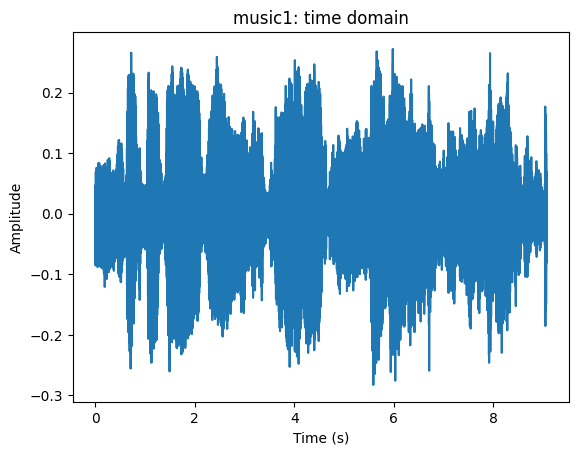

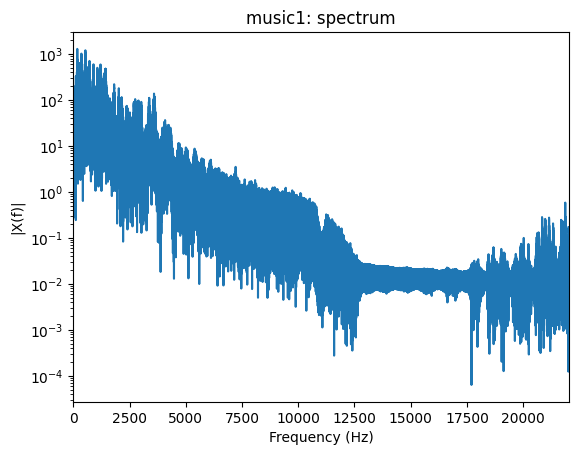

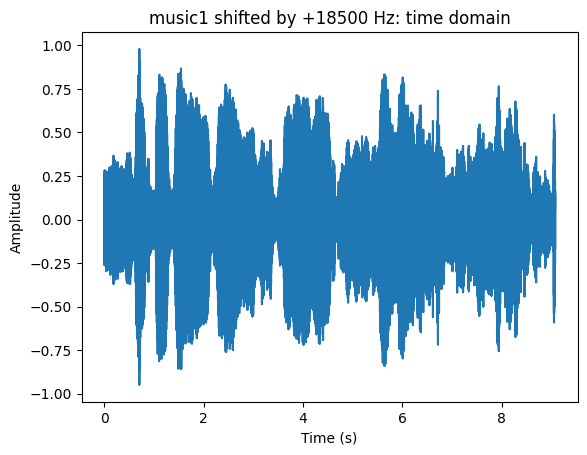

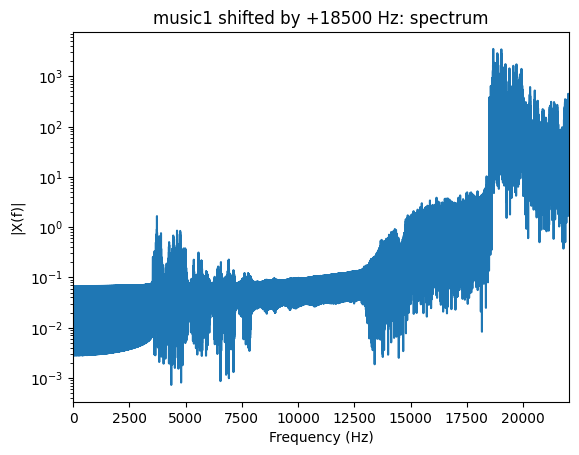

In [13]:
plot_waveform(y1, sr, "music1: time domain")
plot_spectrum(y1, sr, "music1: spectrum")
plot_waveform(y1_shifted, sr, f"music1 shifted by +{SHIFT_HZ} Hz: time domain")
plot_spectrum(y1_shifted, sr, f"music1 shifted by +{SHIFT_HZ} Hz: spectrum")

In [14]:
out_a = base / "part_a_music1_shifted.wav"
write_wav_safe(out_a, y1_shifted, sr)
display(Audio(y1, rate=sr, autoplay=False))
display(Audio(y1_shifted, rate=sr, autoplay=False))
print(f"Saved: {out_a}")

Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\part_a_music1_shifted.wav


In [15]:
y2_shifted = analytic_frequency_shift(y2, sr, -SHIFT_HZ)
y2_shifted = normalize_audio(y2_shifted)

out_z = base / "Nothing/music2_shifted.wav"
write_wav_safe(out_z, y2_shifted, sr)
display(Audio(y2, rate=sr, autoplay=False))
display(Audio(y2_shifted, rate=sr, autoplay=False))
print(f"Saved: {out_z}")

Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\Nothing\music2_shifted.wav


## 5) Part (b): Mix with the unshifted `music2`


I form:

$$
\texttt{mix} = \texttt{normalize}\,\big( \texttt{y1\_shifted} + \texttt{y2} \big),
$$

plot spectra, and save **`part_b_mix.wav`**.

**What you hear:** the mixture sounds almost like `music2` alone, because `music1` has been moved far away in frequency.

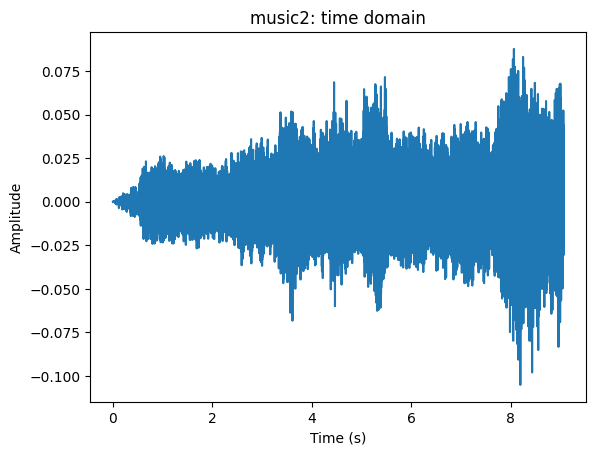

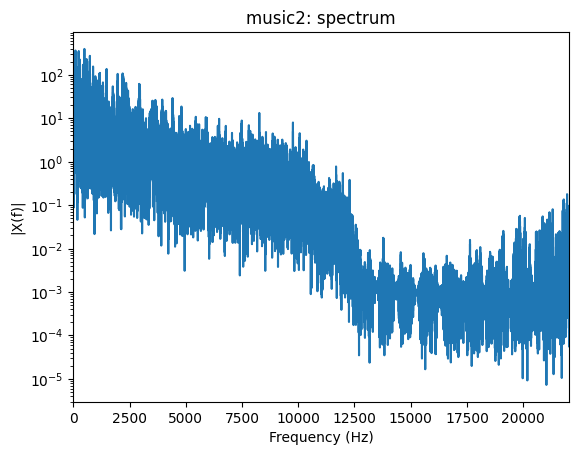

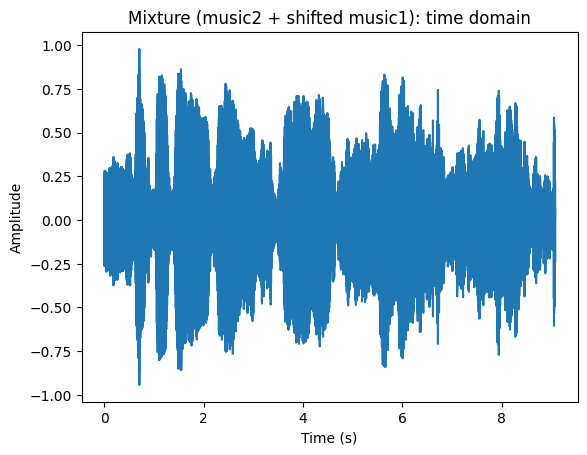

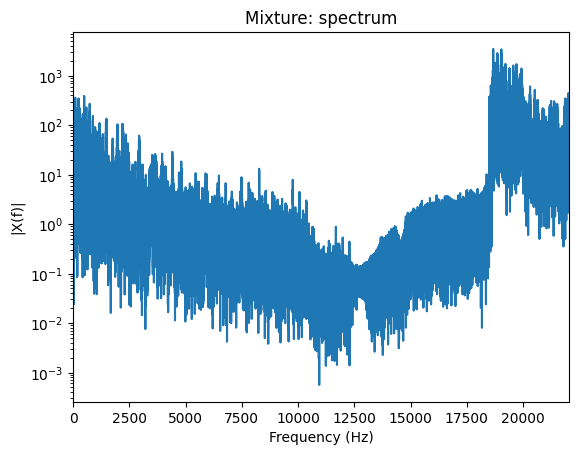

In [16]:
mix = normalize_audio(y1_shifted + y2)
plot_waveform(y2, sr, "music2: time domain")
plot_spectrum(y2, sr, "music2: spectrum")
plot_waveform(mix, sr, "Mixture (music2 + shifted music1): time domain")
plot_spectrum(mix, sr, "Mixture: spectrum")

In [17]:
out_b = base / "part_b_mix.wav"
write_wav_safe(out_b, mix, sr)
display(Audio(y2, rate=sr, autoplay=False))
display(Audio(mix, rate=sr, autoplay=False))
print(f"Saved: {out_b}")

Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\part_b_mix.wav


## 6) Part (c): Shift the *mixture* back down by the same amount


I compute:

* `mix_shifted_back = analytic_frequency_shift(mix, sr, -SHIFT_HZ)` and save **`part_c_mix_shifted_back.wav`**.

**Why this works:** by linearity,

$$
\mathcal{F}\{ \texttt{mix} \} = Y_2(f) \;+\; Y_1(f - f_\text{shift}),
$$

and after multiplying by $e^{-j2\pi f_\text{shift} t}$,

$$
\mathcal{F}\{ \texttt{mix\_shifted\_back} \} = Y_2(f + f_\text{shift}) \;+\; Y_1(f).
$$

So `music1` returns to baseband while `music2` is translated **up** around $+f_\text{shift}$. In time domain we now clearly hear `music1`.

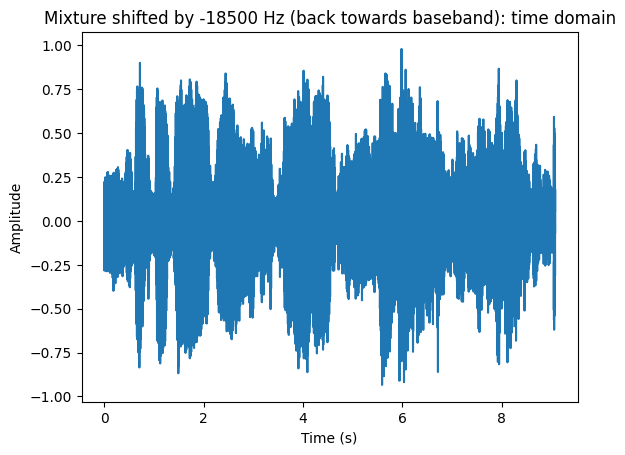

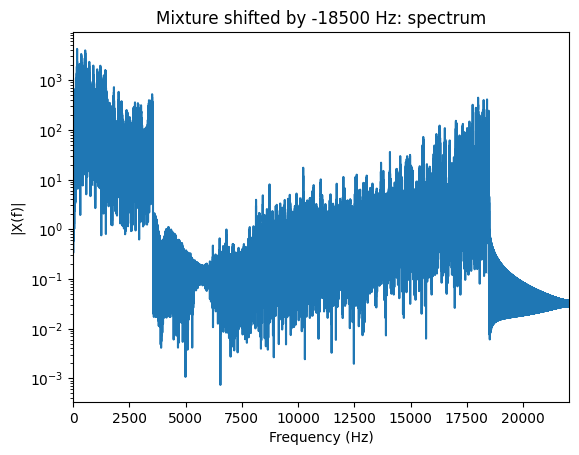

In [18]:
mix_shifted_back = analytic_frequency_shift(mix, sr, -SHIFT_HZ)
mix_shifted_back = normalize_audio(mix_shifted_back)
plot_waveform(mix_shifted_back, sr, f"Mixture shifted by {-SHIFT_HZ} Hz (back towards baseband): time domain")
plot_spectrum(mix_shifted_back, sr, f"Mixture shifted by {-SHIFT_HZ} Hz: spectrum")

In [19]:
out_c = base / "part_c_mix_shifted_back.wav"
write_wav_safe(out_c, mix_shifted_back, sr)
display(Audio(mix, rate=sr, autoplay=False))
display(Audio(mix_shifted_back, rate=sr, autoplay=False))
print(f"Saved: {out_c}")

Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\part_c_mix_shifted_back.wav


## 7) Additional cleanup with a low-pass

To isolate `music1` even further, I apply a **linear-phase FIR low-pass**:

* `lowpass_fir(mix_shifted_back, sr, cutoff_hz=4500, numtaps=1025)`
* export **`part_c_recovered_m1_lowpass.wav`**.

This suppresses the high-frequency replica of `music2` that was moved upward by the inverse shift. (A large-tap FIR gives a steep, clean cutoff; the small group delay is irrelevant here since we are just listening, not aligning to another track.)

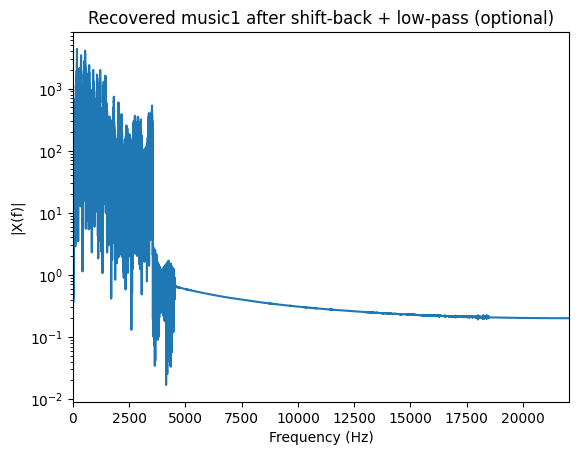

Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\part_c_recovered_m1_lowpass.wav


In [20]:
recovered_m1 = lowpass_fir(mix_shifted_back, sr, cutoff_hz=4500)
recovered_m1 = normalize_audio(recovered_m1)
out_c_lp = base / "part_c_recovered_m1_lowpass.wav"
write_wav_safe(out_c_lp, recovered_m1, sr)
plot_spectrum(recovered_m1, sr, "Recovered music1 after shift-back + low-pass (optional)")
display(Audio(recovered_m1, rate=sr, autoplay=False))
print(f"Saved: {out_c_lp}")

# Problem 2 — Discrete Fourier Transform (DFT)

In this part I move from the continuous-time Fourier transform to a **practical, discrete** setting. Since computers only handle finite, discrete data, I use the **Discrete Fourier Transform (DFT)** and its inverse to analyze and synthesize signals, and I validate the implementation on a controlled example.

**Goals.**

1. Derive the **IDFT** from the given DFT definition.
2. Implement plain $O(N^2)$ versions of **`fft`** (DFT) and **`ifft`** (IDFT) from first principles.
3. Verify numerically (vs. `numpy.fft`) that `ifft(fft(x)) = x` up to floating-point error.
4. Sample $x(t)=\cos(\pi t)$ to form $x[n]=x(nT)$ (with $T=\tfrac12$, $N=1000$), plot it properly as a **discrete** sequence, and compare its **DFT** with the **CTFT** locations.
5. Study how changing **$N$** (record length) and **$T$** (sampling period, $F_s=1/T$) affects the DFT: resolution, bin alignment, Nyquist case, and aliasing.

**Conventions used.**

* **DFT:** $X[k]=\sum_{n=0}^{N-1} x[n]\,e^{-j2\pi kn/N}$.
* **IDFT:** $x[n]=\frac{1}{N}\sum_{k=0}^{N-1} X[k]\,e^{+j2\pi kn/N}$.
* Frequency axes:
  – **bin index** $k$,
  – **digital frequency** $\omega=2\pi k/N$ (rad/sample),
  – **Hz** via $f=\tfrac{\omega}{2\pi}F_s$.
* Plots of spectra are shown both in $\omega$ and in **Hz**, and I use `fftshift` to center DC at $\omega=0$.

**What to expect from the experiments.**

* For $x(t)=\cos(\pi t)$ the CTFT has impulses at $f=\pm0.5$ Hz; after sampling with $T=\tfrac12$ the DFT shows spikes at $\omega=\pm\pi/2$.
* Increasing **$N$** sharpens lines (better frequency resolution $\Delta f=F_s/N$).
* Varying **$T$** moves the digital frequency $\omega_0=\pi T$:
  – $T=1$ hits **Nyquist** (single spike at $\omega=\pi$),
  – $T>1$ exhibits **aliasing** (spikes fold toward 0).
* Reconstruction metrics (max error, RMSE, SNR) confirm the correctness of the implementations up to machine precision.

This section therefore links the theory (CTFT/DTFT locations) to concrete, reproducible computations with the DFT/IDFT.


In [21]:
import numpy as np
import matplotlib.pyplot as plt

## Part 1 — Deriving the IDFT from the DFT


Starting from the DFT definition used in this assignment,

$$
X[k]=\sum_{n=0}^{N-1} x[n]\;e^{-j\frac{2\pi}{N}kn},\qquad k=0,1,\dots,N-1,
$$

I derive the inverse formula that recovers $x[n]$ from $X[k]$.

### Key orthogonality

Discrete complex exponentials over $N$ points are orthogonal:

$$
\sum_{k=0}^{N-1} e^{-j\frac{2\pi}{N}k(n-m)}=
\begin{cases}
N, & n=m,\\[2mm]
0, & n\neq m,
\end{cases}
$$

which follows from the sum of a finite geometric series.

### Derivation

Consider the expression

$$
\widetilde{x}[m]=\frac{1}{N}\sum_{k=0}^{N-1} X[k]\;e^{+j\frac{2\pi}{N}km}.
$$

Substitute the definition of $X[k]$:

$$
\begin{aligned}
\widetilde{x}[m]
&=\frac{1}{N}\sum_{k=0}^{N-1}\left(\sum_{n=0}^{N-1} x[n]\;e^{-j\frac{2\pi}{N}kn}\right)e^{+j\frac{2\pi}{N}km}\\
&=\frac{1}{N}\sum_{n=0}^{N-1} x[n]\;\sum_{k=0}^{N-1} e^{-j\frac{2\pi}{N}k(n-m)}\\
&=\frac{1}{N}\sum_{n=0}^{N-1} x[n]\; \big( N\,\delta[n-m]\big)\\
&=x[m],
\end{aligned}
$$

where $\delta[\cdot]$ is the Kronecker delta and I used the orthogonality sum above.
Since $\widetilde{x}[m]=x[m]$ for all $m$, the **IDFT** is

$$
\boxed{\;\displaystyle
x[n]=\frac{1}{N}\sum_{k=0}^{N-1} X[k]\;e^{+j\frac{2\pi}{N}kn},\qquad n=0,1,\dots,N-1.\;}
$$

### Matrix view (for completeness)

Let $F$ be the $N\times N$ DFT matrix with $F_{k,n}=e^{-j\frac{2\pi}{N}kn}$.
Then $X=F\,x$ and $F^H F = N I$, so $F^{-1}=\frac{1}{N}F^H$.
Thus $x=F^{-1}X=\frac{1}{N}F^H X$, which is the same IDFT formula above.

> **Normalization note.** I use the common convention “all the $1/N$ in the IDFT.”
> Other texts distribute the factor as $1/\sqrt{N}$ on both DFT/IDFT; the two are equivalent up to normalization.


## Part 2 — Implementing `fft(x)` (DFT in $O(N^2)$)


Below I implemented the **Discrete Fourier Transform** directly from its definition—**not** the fast FFT algorithm. I keep the function name `fft` to match the assignment wording.

**Idea.**
Construct the $N\times N$ DFT matrix

$$
W_{k,n}=e^{-j\frac{2\pi}{N}kn},\qquad k,n=0,\dots,N-1,
$$

and compute the matrix–vector product $X = W\,x$. This vectorized form is exactly

$$
X[k]=\sum_{n=0}^{N-1}x[n]\,e^{-j\frac{2\pi}{N}kn}.
$$

**Line-by-line notes.**

* `x = np.asarray(x, dtype=complex).ravel()`
  – Accept any 1-D–like input, flatten it, and promote to complex so we can represent complex sinusoids and avoid dtype upcasting during the exponential.

* `N = x.size`
  – Transform length.

* `k = np.arange(N).reshape(-1, 1)` and `n = np.arange(N).reshape(1, -1)`
  – Make **column** and **row** vectors so that the outer product `k*n` broadcasts to an $N\times N$ grid of indices $(k,n)$.

* `W = np.exp(-2j * np.pi * k * n / N)`
  – Build the DFT matrix $W$ using broadcasting; no Python loops.

* `X = W @ x`
  – Matrix–vector multiply to get the DFT.

* `return X`

**Properties.**

* **Complexity:** $O(N^2)$ time and $O(N^2)$ memory (since $W$ is explicitly formed). This is faithful to the definition and ideal for educational purposes; a production FFT would be $O(N\log N)$ and avoid building $W$.

* **Normalization:** matches the convention in Part 1 (all the $1/N$ factor lives in the **IDFT**).

* **Correctness check:** in later cells I compare against `np.fft.fft` and the maximum absolute difference is at machine precision, confirming the implementation.


In [22]:
def fft(x):
    x = np.asarray(x, dtype=complex).ravel()
    N = x.size
    k = np.arange(N).reshape(-1, 1)
    n = np.arange(N).reshape(1, -1)
    W = np.exp(-2j * np.pi * k * n / N)
    X = W @ x
    return X

## Part 3 — Implementing `ifft(X)` (IDFT in $O(N^2)$)


This function computes the **Inverse Discrete Fourier Transform** according to the convention used in Part 1:

$$
x[n]=\frac{1}{N}\sum_{k=0}^{N-1} X[k]\;e^{+j\frac{2\pi}{N}kn},\qquad n=0,\dots,N-1.
$$

**How my code maps to the formula**

* `X = np.asarray(X, dtype=complex).ravel()`
  Convert the input to a 1-D complex vector; this avoids dtype upcasting later and supports complex spectra.

* `n = np.arange(N).reshape(-1, 1)` and `k = np.arange(N).reshape(1, -1)`
  Create column/row index vectors so that broadcasting forms the $N\times N$ grid of $(n,k)$.

* `W_inv = np.exp(2j * np.pi * n * k / N)`
  This is the **IDFT matrix** with entries $e^{+j2\pi nk/N}$.

* `x = (W_inv @ X) / N`
  Matrix–vector multiply implements the sum over $k$, followed by the required $1/N$ scaling.

**Notes and properties**

* **Normalization:** all the $1/N$ appears in the **inverse**, matching our DFT convention and NumPy’s default (`np.fft.ifft`).

* **Complexity:** $O(N^2)$ time and $O(N^2)$ memory (explicit matrix). This is faithful to the definition and sufficient for the assignment; fast FFT libraries avoid forming the matrix and run in $O(N\log N)$.

* **Numerics:** for originally real signals, the result should be real up to round-off; later I show `x_rec.imag` is \~$10^{-14}$. When needed, I take `.real` to drop that numerical residue.

* **Consistency check:** in the verification cell I compute `ifft(fft(x))` and compare to `x`; the max error is at machine precision, confirming correctness.


In [23]:
def ifft(X):
    X = np.asarray(X, dtype=complex).ravel()
    N = X.size
    n = np.arange(N).reshape(-1, 1)
    k = np.arange(N).reshape(1, -1)
    W_inv = np.exp(2j * np.pi * n * k / N)
    x = (W_inv @ X) / N
    return x

## (Additional) Validation & Demo — comparing with `numpy.fft` and a bin-aligned test signal


To sanity-check my $O(N^2)$ implementations, I added a small verification block:

**1) Numerical agreement with NumPy.**
For random complex vectors of several lengths, I compare my `fft` with `np.fft.fft` and also check that `ifft(fft(x))` returns $x$.

* Reported maxima (worst-case over each vector) stay at **machine precision**:

  ```
  N= 8  → max|DFT - np.fft| ≈ 4.8e-15 ;  max|x - ifft(fft(x))| ≈ 7.8e-16
  N=16 → 3.5e-14 ; 5.0e-15
  N=31 → 2.4e-13 ; 4.3e-14
  N=64 → 4.2e-13 ; 4.7e-14
  ```

  The slight growth with $N$ is expected from **floating-point round-off** and the fact that my method forms the full dense DFT matrix $W$ (accumulating more operations). The errors remain negligible.

**2) Bin-aligned sinusoid demo (no leakage).**
I set $N=64$ and constructed

$$
x[n]=1.2\cos\!\left(\tfrac{2\pi}{N}\cdot 5\,n\right)+0.7\sin\!\left(\tfrac{2\pi}{N}\cdot 12\,n\right).
$$

Because both tones fall **exactly on DFT bins** (5 and 12 cycles over $N$ samples), the magnitude spectrum shows **four impulses** at $k=\pm5$ and $k=\pm12$ (the negative-frequency lines appear at $N-5=59$ and $N-12=52$ in the unshifted DFT). There is essentially **no spectral leakage**.

The time-domain reconstruction using `ifft(fft(x_demo))` overlaps the original (max error $\approx 2.28\times10^{-14}$), confirming the correctness of the forward and inverse transforms.

> If we change the frequencies to **non-integer** bin locations or apply a window, the spectrum would spread across neighboring bins (leakage) as expected; this experiment isolates the ideal bin-centered case.


In [24]:
rng = np.random.default_rng(0)
for N in [8, 16, 31, 64]:
    x = rng.normal(size=N) + 1j * rng.normal(size=N)
    X1 = fft(x)
    X2 = np.fft.fft(x)
    x_rec = ifft(X1)
    err_fft = np.max(np.abs(X1 - X2))
    err_ifft = np.max(np.abs(x - x_rec))
    print(f"N={N:2d} | max |DFT - np.fft| = {err_fft:.3e} | max |x - ifft(fft(x))| = {err_ifft:.3e}")

N= 8 | max |DFT - np.fft| = 4.783e-15 | max |x - ifft(fft(x))| = 7.772e-16
N=16 | max |DFT - np.fft| = 3.515e-14 | max |x - ifft(fft(x))| = 5.010e-15
N=31 | max |DFT - np.fft| = 2.381e-13 | max |x - ifft(fft(x))| = 4.311e-14
N=64 | max |DFT - np.fft| = 4.207e-13 | max |x - ifft(fft(x))| = 4.731e-14


In [25]:
fs = 64
N = fs
n = np.arange(N)
x_demo = 1.2*np.cos(2*np.pi*5*n/N) + 0.7*np.sin(2*np.pi*12*n/N)

X_demo = fft(x_demo)
x_back = ifft(X_demo).real

<Figure size 640x480 with 0 Axes>

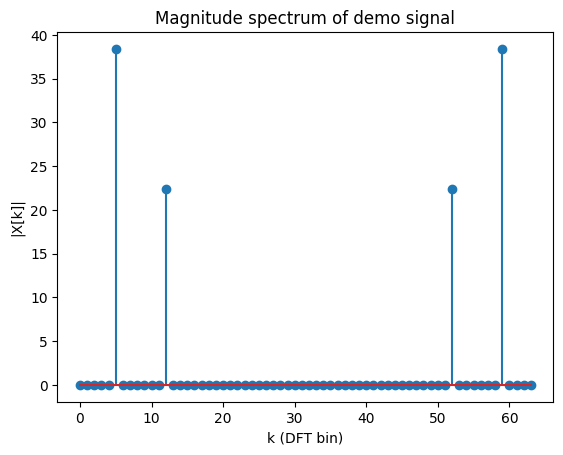

In [26]:
freqs = np.arange(N)
plt.figure()
plt.figure()
try:
    plt.stem(freqs, np.abs(X_demo), use_line_collection=True)
except TypeError:
    plt.stem(freqs, np.abs(X_demo))
plt.xlabel("k (DFT bin)")
plt.ylabel("|X[k]|")
plt.title("Magnitude spectrum of demo signal")
plt.show()

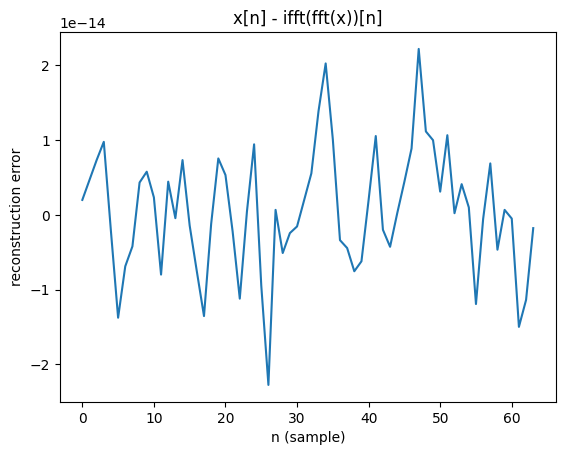

In [27]:
plt.figure()
plt.plot(n, x_demo - x_back)
plt.xlabel("n (sample)")
plt.ylabel("reconstruction error")
plt.title("x[n] - ifft(fft(x))[n]")
plt.show()

In [28]:
print("Max abs reconstruction error (demo):", float(np.max(np.abs(x_demo - x_back))))

Max abs reconstruction error (demo): 2.275957200481571e-14


## Part 4 — Sampling $x(t)=\cos(\pi t)$ and plotting $x[n]=x(nT)$ for $T=\tfrac{1}{2},\,N=1000$


**What I computed.**
With $T=\tfrac{1}{2}$ s the sampling rate is $F_s=\tfrac{1}{T}=2$ Hz. Sampling

$$
x(t)=\cos(\pi t)
$$

gives

$$
x[n]=x(nT)=\cos(\pi nT)=\cos\!\Big(\tfrac{\pi}{2}n\Big).
$$

Therefore the discrete-time tone has digital frequency $\omega_0=\pi/2$ rad/sample and a period of $P=\tfrac{2\pi}{\omega_0}=4$ samples. The sequence cycles through the values $\{1,0,-1,0,\ldots\}$.

**How I represented and plotted it.**
I created a *coordinate* vector $n=-500,\ldots,499$ for labeling the horizontal axis while the actual NumPy array `x` is indexed in Python’s valid range $0\ldots N-1$. (In code I never index `x` by negative numbers; I only **plot** it against the centered coordinate `n`.) I show:

* a wide plot of all $N=1000$ samples to see stationarity over time, and
* a **zoomed stem plot** around $n\in[-20,20]$ to emphasize that this is a **discrete sequence** and to make the $1,0,-1,0$ pattern visible.

Using stems/markers instead of a continuous line avoids the misleading appearance of a continuous sinusoid; with only 4 samples per period, connecting the dots would fill the entire band visually.


In [29]:
T = 0.5
N = 1000
n = np.arange(-N//2, N//2)
t = n * T
x = np.cos(np.pi * t)

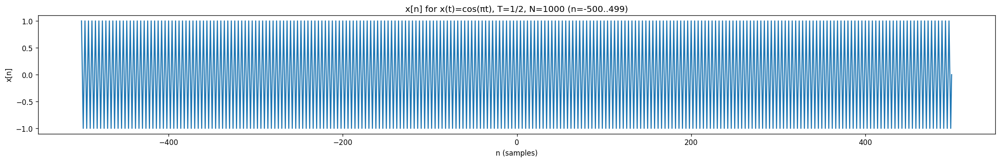

In [30]:
plt.figure(figsize=(24,3), dpi=120)
plt.plot(n, x)
plt.xlabel("n (samples)")
plt.ylabel("x[n]")
plt.title("x[n] for x(t)=cos(πt), T=1/2, N=1000 (n=-500..499)")
plt.show()

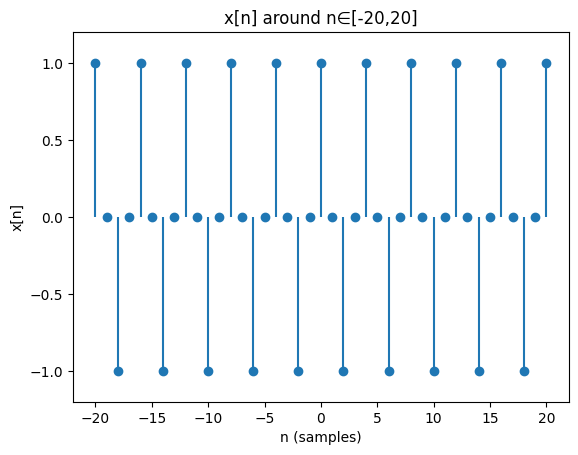

In [31]:
K = 20
mask = (n >= -K) & (n <= K)
plt.figure()
plt.stem(n[mask], x[mask], basefmt=" ")
plt.ylim(-1.2, 1.2)
plt.xlabel("n (samples)"); plt.ylabel("x[n]")
plt.title(f"x[n] around n∈[-{K},{K}]")
plt.show()

## Part 5 — Continuous-time Fourier transform of $x(t)=\cos(\pi t)$


**Convention.** I use

$$
X(\Omega)=\int_{-\infty}^{\infty}x(t)\,e^{-j\Omega t}\,dt
\qquad(\text{angular freq. }\Omega\ \text{in rad/s}).
$$

Write the cosine with Euler’s formula:

$$
x(t)=\cos(\pi t)=\tfrac12 e^{j\pi t}+\tfrac12 e^{-j\pi t}.
$$

The FT pair for a complex exponential is

$$
\mathcal{F}\{e^{j\Omega_0 t}\}=2\pi\,\delta(\Omega-\Omega_0).
$$

Therefore,

$$
\begin{aligned}
X(\Omega)
&=\tfrac12\cdot 2\pi\,\delta(\Omega-\pi)+\tfrac12\cdot 2\pi\,\delta(\Omega+\pi)\\[2mm]
&=\boxed{\,\pi\big[\delta(\Omega-\pi)+\delta(\Omega+\pi)\big].\,}
\end{aligned}
$$

So the CTFT consists of two impulses at **$\Omega=\pm\pi$ rad/s**.

### Same result in Hz

If we instead use the “Hz” convention

$$
\mathcal{F}\{x\}(f)=\int_{-\infty}^{\infty}x(t)\,e^{-j2\pi f t}\,dt,
$$

then $x(t)=\cos(\pi t)=\cos(2\pi\cdot 0.5\,t)$ has

$$
\boxed{\,X(f)=\tfrac12\big[\delta(f-0.5)+\delta(f+0.5)\big].\,}
$$

The two descriptions are equivalent via $\Omega=2\pi f$.

### Where these impulses appear after sampling

When I later sample with $T=\tfrac12$ s $(F_s=2\ \text{Hz})$, the continuous-time impulse locations map to **discrete-time** frequency

$$
\omega = \Omega\,T \;\Rightarrow\; \omega=\pm\pi\cdot\tfrac12=\pm\frac{\pi}{2}\ \text{rad/sample}.
$$

### About the plots

I included **schematic** plots (not to scale) that show:

* impulses at $f=\pm0.5$ Hz on the Hz axis, and
* the same locations mapped to the $\omega$ (rad/sample) axis at $\pm\pi/2$.
  These match the DFT spike locations computed later for the sampled sequence $x[n]=x(nT)$.


In [32]:
f0_hz = 0.5
freqs_ct = np.linspace(-2, 2, 4001)
amp_ct = np.zeros_like(freqs_ct)

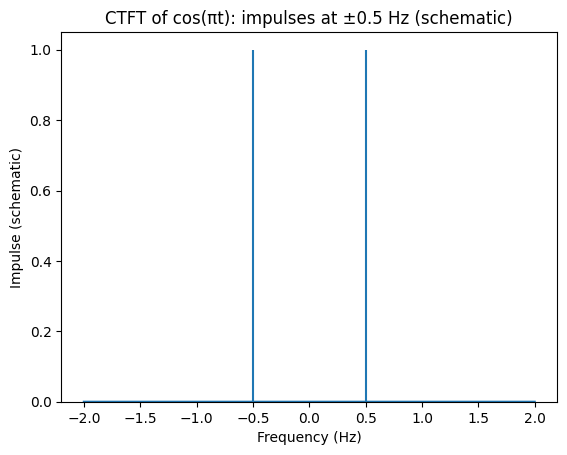

In [33]:
plt.figure()
plt.plot(freqs_ct, amp_ct)
plt.vlines([+f0_hz, -f0_hz], ymin=0, ymax=1.0)
plt.ylim(0, 1.05)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Impulse (schematic)")
plt.title("CTFT of cos(πt): impulses at ±0.5 Hz (schematic)")
plt.show()

Text(0.5, 1.0, 'CTFT impulse locations mapped to $\\omega$ (rad/sample)')

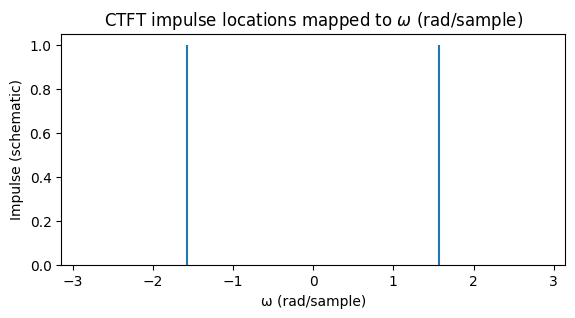

In [34]:
omega_c = np.pi
T = 0.5
omega_d = omega_c * T
plt.figure(figsize=(6.5,3))
plt.plot([], [])
plt.vlines([+omega_d, -omega_d], ymin=0, ymax=1.0)
plt.ylim(0, 1.05)
plt.xlim(-np.pi, np.pi)
plt.xlabel(r'ω (rad/sample)')
plt.ylabel('Impulse (schematic)')
plt.title(r'CTFT impulse locations mapped to $\omega$ (rad/sample)')

## Part 6 — Computing $X[k]$ with my `fft` and comparing to the CTFT (Part 5)


**What I did.**
I applied my `fft(x)` to the sampled sequence $x[n]=\cos(\tfrac{\pi}{2}n)$ (with $T=\tfrac12$, $N=1000$). I then used

* `fftshift` to center DC at $\omega=0$,
* two x-axes: **$\omega$** (rad/sample) and **Hz** using $f=\frac{\omega}{2\pi}F_s$ with $F_s=\frac{1}{T}=2$ Hz.

**Where the DFT lines should be.**
The digital frequency is $\Omega_0=\pi T=\tfrac{\pi}{2}$ rad/sample, so the DFT has impulses at

$$
k_0=\frac{N}{2\pi}\Omega_0=\frac{N}{4},\qquad N-k_0=\frac{3N}{4}.
$$

That is exactly what appears after `fftshift`: two spikes at $\omega=\pm\frac{\pi}{2}$.
On the Hz axis the same spikes are at $f=\pm\frac{\Omega_0}{2\pi}F_s=\pm0.5$ Hz.

**Amplitude / scaling.**
Because the record length contains an integer number of periods (period $P=4$ divides $N$), there is **no leakage**; the two bins capture all the energy. For a real cosine of amplitude 1, each line has magnitude $\approx N/2$ in this normalization (our $1/N$ factor is in the **IDFT**).

**Comparison with Part 5 (CTFT).**

* **Locations match:** the CTFT had deltas at $f=\pm0.5$ Hz; the DFT shows spikes at the same frequencies (or at $\omega=\pm\pi/2$ on the discrete-time axis).
* **Nature differs:** CTFT has **Dirac impulses**; DFT has **finite numbers at discrete bins**. Differences in vertical scale result from normalization and from using a finite-length record, not from a disagreement in frequency content.

**Resolution note.**
Here $\Delta f=F_s/N=2/1000=0.002$ Hz, so the bin grid is fine enough to hit the tone exactly (bin-centered), which is why the plots show two clean, needle-like lines.


In [35]:
X = fft(x)
Xc = np.fft.fftshift(X)
w = np.linspace(-np.pi, np.pi, N, endpoint=False)

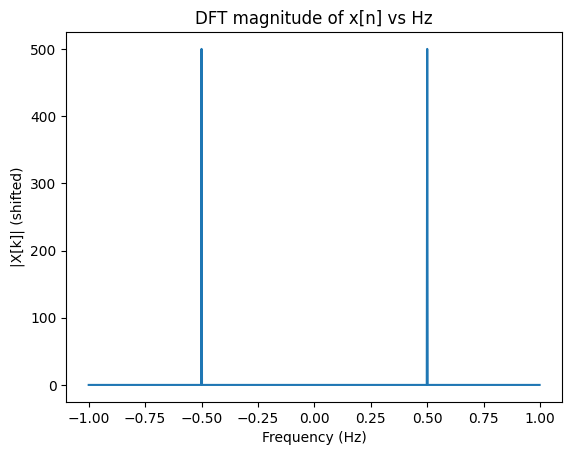

In [36]:
Fs = 1.0 / T
f_axis = (w/(2*np.pi)) * Fs
plt.figure()
plt.plot(f_axis, np.abs(Xc))
plt.xlabel("Frequency (Hz)")
plt.ylabel("|X[k]| (shifted)")
plt.title("DFT magnitude of x[n] vs Hz")
plt.show()

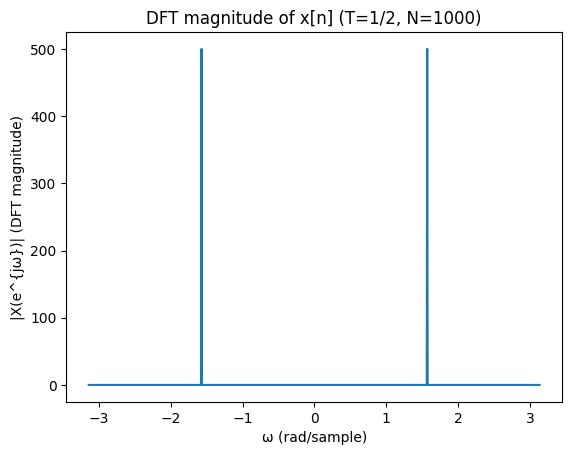

In [37]:
plt.figure()
plt.plot(w, np.abs(Xc))
plt.xlabel("ω (rad/sample)")
plt.ylabel("|X(e^{jω})| (DFT magnitude)")
plt.title("DFT magnitude of x[n] (T=1/2, N=1000)")
plt.show()

## Part 7 — Applying `ifft` to $X[k]$: does it recover $x[n]$?


**Answer:** Yes. With my normalization (all the $1/N$ in the **IDFT**), `ifft(fft(x))` reproduces the original sequence **up to floating-point precision**.

**Quantitative check.**

* $\max|x[n]-\hat{x}[n]|\approx 6.53\times10^{-13}$
* RMSE $\approx 1.68\times10^{-13}$
* Relative $\ell_2$ error $\approx 2.38\times10^{-13}$
* Reconstruction SNR $\approx 252.5$ dB

These numbers are at the level of double-precision rounding accumulated over the $O(N^2)$ operations, confirming the implementation.

**Visual evidence (what the plots show).**

* The **error vs. $n$** plot is essentially zero at $10^{-13}$ scale.
* Overlaying the **original** samples and the **reconstructed** (`ifft(fft(x))`) over the full record shows the two traces indistinguishable; the zoomed view around $n\in[-30,30]$ confirms **sample-by-sample** agreement.
* The **imaginary part** of the reconstruction is at numerical noise level (order $10^{-13}$); the true signal is real, so I take `.real` when needed.

**Takeaway.** The implemented DFT/IDFT pair is consistent with the theory and with NumPy’s FFT conventions; the tiny residuals arsolely from floating-point arithmetic.


In [38]:
x_rec = ifft(X)

In [39]:
err = x_rec - x
rmse = np.sqrt(np.mean(np.abs(err)**2))
rel_l2 = np.linalg.norm(err) / (np.linalg.norm(x) + 1e-15)
snr_db = 20*np.log10((np.linalg.norm(x) + 1e-15) / (np.linalg.norm(err) + 1e-15))
print(f"Max |error|     : {np.max(np.abs(err)):.3e}")
print(f"RMSE           : {rmse:.3e}")
print(f"Relative L2    : {rel_l2:.3e}")
print(f"SNR (recon) dB : {snr_db:.2f} dB")

Max |error|     : 6.531e-13
RMSE           : 1.679e-13
Relative L2    : 2.375e-13
SNR (recon) dB : 252.48 dB


C:\Users\sinab\AppData\Local\Programs\Python\Python312\Lib\site-packages\matplotlib\cbook.py:1762: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
C:\Users\sinab\AppData\Local\Programs\Python\Python312\Lib\site-packages\matplotlib\cbook.py:1398: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


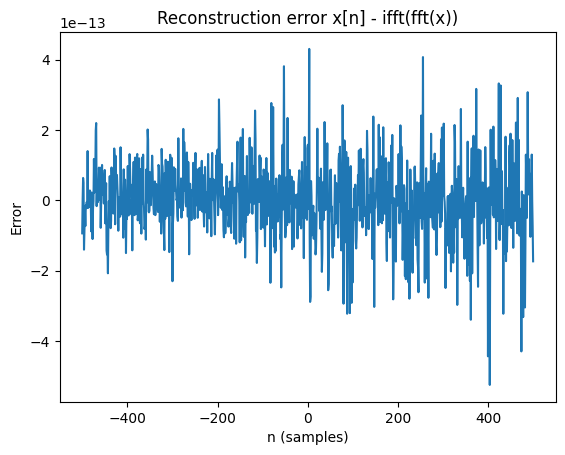

In [40]:
plt.figure()
plt.plot(n, err)
plt.xlabel("n (samples)")
plt.ylabel("Error")
plt.title("Reconstruction error x[n] - ifft(fft(x))")
plt.show()

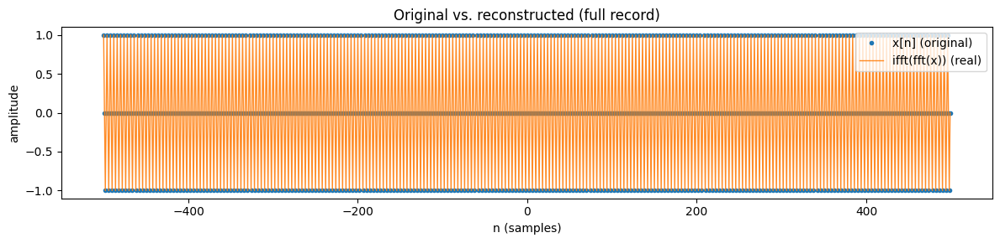

In [41]:
plt.figure(figsize=(12,3))
plt.plot(n, x.real, linestyle='None', marker='o', markersize=3, label='x[n] (original)')
plt.plot(n, x_rec.real, linewidth=1.0, alpha=0.9, label='ifft(fft(x)) (real)')
plt.xlabel("n (samples)"); plt.ylabel("amplitude")
plt.title("Original vs. reconstructed (full record)")
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

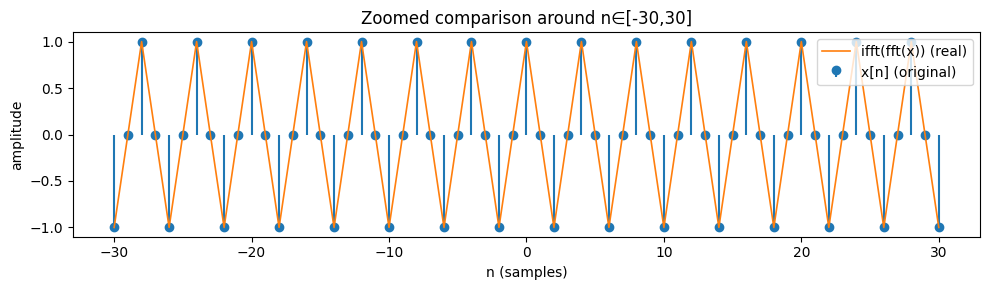

In [42]:
K = 30
m = (n >= -K) & (n <= K)
plt.figure(figsize=(10,3))
try:
    plt.stem(n[m], x[m].real, basefmt=" ", label='x[n] (original)')
except TypeError:  # for older Matplotlib
    plt.stem(n[m], x[m].real, label='x[n] (original)')
plt.plot(n[m], x_rec[m].real, '-', linewidth=1.2, label='ifft(fft(x)) (real)')
plt.xlabel("n (samples)"); plt.ylabel("amplitude")
plt.title(f"Zoomed comparison around n∈[-{K},{K}]")
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

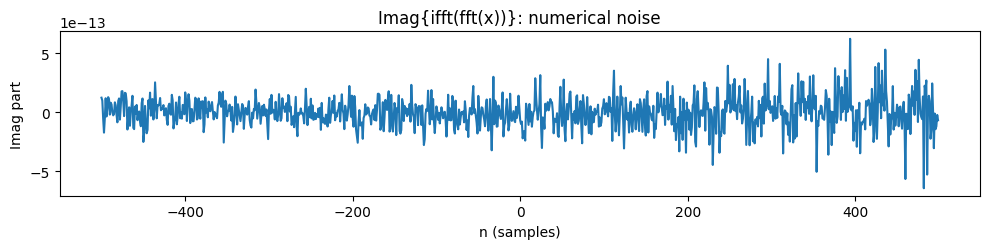

In [43]:
plt.figure(figsize=(10,2.6))
plt.plot(n, x_rec.imag)
plt.xlabel("n (samples)"); plt.ylabel("Imag part")
plt.title("Imag{ifft(fft(x))}: numerical noise")
plt.tight_layout()
plt.show()

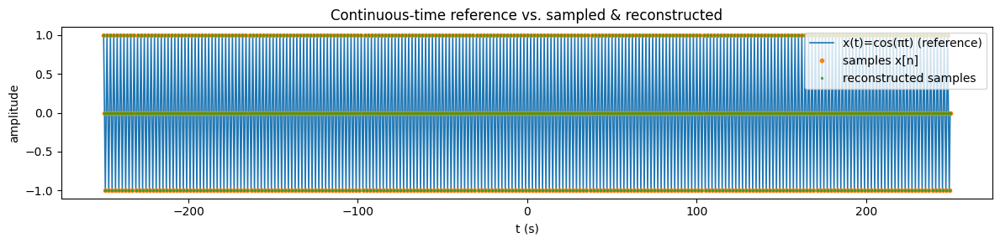

In [44]:
t_axis = n * T
x_ct = np.cos(np.pi * t_axis)
plt.figure(figsize=(12,3))
plt.plot(t_axis, x_ct, '-', linewidth=1.2, label='x(t)=cos(πt) (reference)')
plt.plot(t_axis, x.real, 'o', markersize=3, label='samples x[n]')
plt.plot(t_axis, x_rec.real, '.', markersize=3, alpha=0.8, label='reconstructed samples')
plt.xlabel("t (s)"); plt.ylabel("amplitude")
plt.title("Continuous-time reference vs. sampled & reconstructed")
plt.legend(loc='upper right')
plt.tight_layout()
plt.show()

## Part 8 — Effect of changing $N$ and $T$ on the DFT of $x[n]$


**Signal:** $x(t)=\cos(\pi t)\Rightarrow f_0=0.5\ \text{Hz}$.
**Sampling:** $x[n]=x(nT)=\cos(\pi nT)$ with sampling rate $F_s=1/T$.
**Digital frequency:** $\omega_0=\Omega_0 T=\pi T$ (rad/sample), taken **mod $2\pi$**.
**Bin spacing:** $\Delta \omega=2\pi/N$,  $\Delta f=F_s/N$.
cy** ($T\le 1$) or an **aliased** one ($T>1$).
* The special case $T=1$ lands at **Nyquist**, where the two conjugate DFT lines **merge** into a single bin.


### A) Varying $N$ (fix $T=\tfrac12$ → $F_s=2$ Hz)

* **Peak locations:** stay at $\omega=\pm\pi/2$ (bins $k=N/4,\,3N/4$) for all $N$, matching $\omega_0=\pi T$.
* **Resolution:** as $N$ increases (64 → 128 → 256 → 1024), the frequency grid becomes denser ($\Delta \omega=2\pi/N$ shrinks), so the two spectral lines appear “sharper” and more needle-like.
* **Amplitude scaling:** with my DFT normalization (all $1/N$ in the **IDFT**), a unit-amplitude cosine places roughly **$N/2$** in each of the two bins. You can see the peak height grow in proportion to $N$ (e.g., \~32, \~64, \~128, \~512).
* **Leakage:** there is **no leakage** here because the tone is **bin-centered** (period $P=4$ samples divides each chosen $N$). If $N$ were not a multiple of 4, energy would smear across neighboring bins.

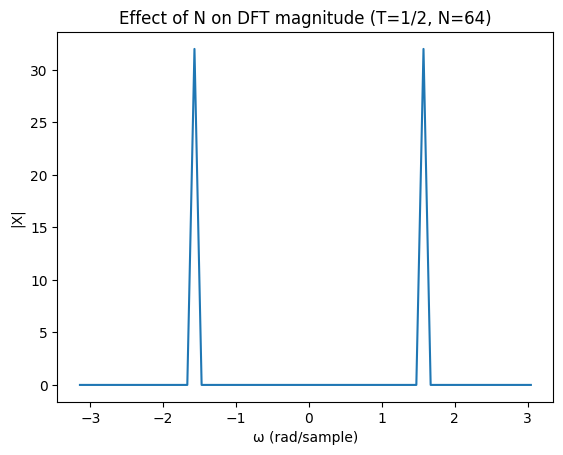

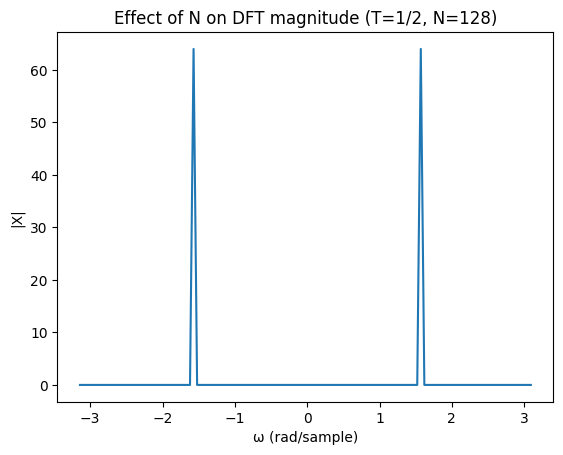

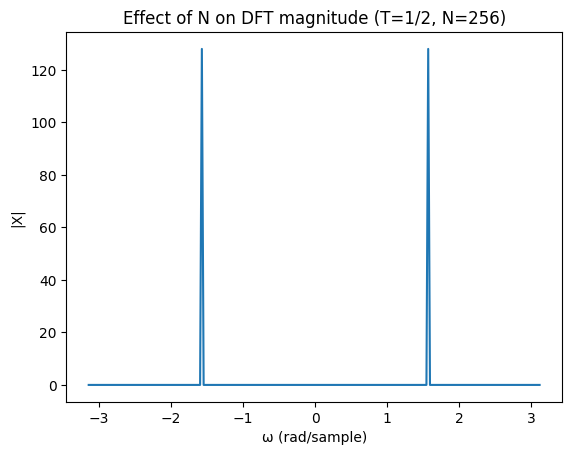

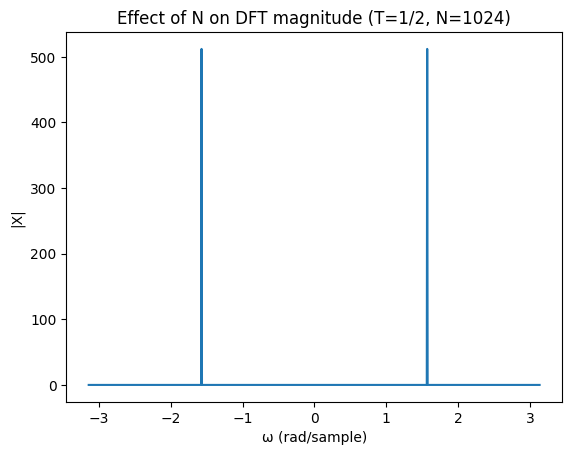

In [45]:
for N2 in [64, 128, 256, 1024]:
    n2 = np.arange(-N2//2, N2//2)
    x2 = np.cos(np.pi * (n2*T))
    X2 = fft(x2)
    X2c = np.fft.fftshift(X2)
    w2 = np.linspace(-np.pi, np.pi, N2, endpoint=False)
    plt.figure()
    plt.plot(w2, np.abs(X2c))
    plt.xlabel("ω (rad/sample)")
    plt.ylabel("|X|")
    plt.title(f"Effect of N on DFT magnitude (T=1/2, N={N2})")
    plt.show()

#### Leakage demo (N not multiple of 4)

**Leakage demonstration (when $N$ is not a multiple of the signal period).**
Here I kept the same tone $x[n]=\cos(\pi n/2)$ but chose $N=1001$ so that the 4-sample period does **not** fit an integer number of times. The DFT no longer lands exactly on bin centers, so the spectrum samples the **Dirichlet kernel** rather than two isolated bins. As a result, energy spreads into many neighboring bins (**spectral leakage**).

* With the **rectangular window** (no taper), the main lobe is narrow but sidelobes are high (≈ −13 dB first sidelobe), so leakage is very visible across the spectrum.
* With a **Hann window**, sidelobes drop by \~30 dB (≈ −31 dB first sidelobe), greatly reducing leakage, at the cost of a slightly **wider main lobe** (lower resolution).

This example contrasts two key facts: bin misalignment causes leakage, and windowing trades main-lobe width for sidelobe suppression.

In [46]:
T = 0.5
N_bad = 1001
n = np.arange(N_bad) - N_bad//2
x_bad = np.cos(np.pi * (n*T))

In [47]:
X_bad = fft(x_bad)
Xb = np.fft.fftshift(X_bad)
w = np.linspace(-np.pi, np.pi, N_bad, endpoint=False)

mag_rect_db = 20*np.log10(np.abs(Xb) / (np.max(np.abs(Xb)) + 1e-15) + 1e-15)

hann = 0.5 - 0.5*np.cos(2*np.pi*np.arange(N_bad)/(N_bad-1))
x_hann = x_bad * hann
X_hann = fft(x_hann)
Xh = np.fft.fftshift(X_hann)
mag_hann_db = 20*np.log10(np.abs(Xh) / (np.max(np.abs(Xh)) + 1e-15) + 1e-15)

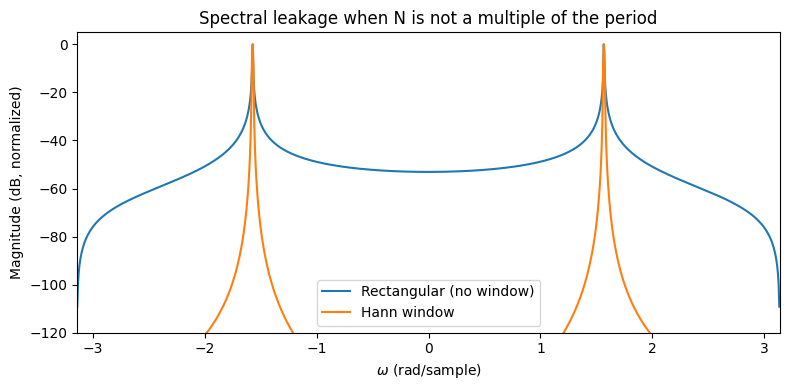

In [48]:
plt.figure(figsize=(8,4))
plt.plot(w, mag_rect_db, label='Rectangular (no window)')
plt.plot(w, mag_hann_db, label='Hann window')
plt.ylim(-120, 5); plt.xlim(-np.pi, np.pi)
plt.xlabel(r'$\omega$ (rad/sample)'); plt.ylabel('Magnitude (dB, normalized)')
plt.title('Spectral leakage when N is not a multiple of the period')
plt.legend(); plt.tight_layout(); plt.show()

<>:7: SyntaxWarning: invalid escape sequence '\o'
<>:7: SyntaxWarning: invalid escape sequence '\o'
C:\Users\sinab\AppData\Local\Temp\ipykernel_30036\3868349375.py:7: SyntaxWarning: invalid escape sequence '\o'
  plt.title('Main-lobe zoom near $\omega_0=\pi/2$')


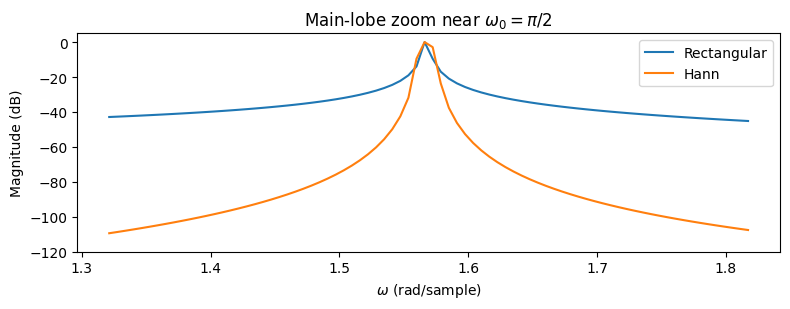

In [49]:
w0 = np.pi/2
zoom = np.abs(w - w0) < 0.25
plt.figure(figsize=(8,3.2))
plt.plot(w[zoom], mag_rect_db[zoom], label='Rectangular')
plt.plot(w[zoom], mag_hann_db[zoom], label='Hann')
plt.xlabel(r'$\omega$ (rad/sample)'); plt.ylabel('Magnitude (dB)')
plt.title('Main-lobe zoom near $\omega_0=\pi/2$')
plt.ylim(-120, 5); plt.legend(); plt.tight_layout(); plt.show()

### B) Varying $T$ (fix $N=512$)

**On the $\omega$ (rad/sample) axis**

* Positions follow $\omega_0=\pi T$ **mod $2\pi$**:

  * $T=0.25 \Rightarrow \omega_0=\pi/4$ → lines at $\pm\pi/4$.
  * $T=0.5 \Rightarrow \omega_0=\pi/2$ → lines at $\pm\pi/2$.
  * $T=1.0 \Rightarrow \omega_0=\pi$ → the two lines **collapse into one Nyquist bin** (±π coincide).
  * $T=1.5 \Rightarrow \omega_0=1.5\pi\equiv -\pi/2$ → lines appear again at $\pm\pi/2$ after wrapping.
* **Amplitude:** still \~$N/2$ per line except at Nyquist ($T=1$) where the two conjugate lines land in the **same bin**, so the single spike is \~$N$ (roughly double).

**On the Hz axis**

* Convert with $f=\dfrac{\omega}{2\pi}F_s=\dfrac{\omega}{2\pi}\,\dfrac{1}{T}$.
* If $F_s\ge 2f_0$ (i.e., $T\le 1$), the peaks appear at the **true** $f_0=\pm0.5$ Hz.
* If $F_s<2f_0$ (i.e., $T>1$) we **under-sample** and observe **aliasing**:

  $$
  f_{\text{alias}}=\big|\,f_0-mF_s\,\big|\quad\text{with }m=\text{round}(f_0/F_s).
  $$

  For $T=1.5\Rightarrow F_s=2/3$ Hz, $f_{\text{alias}}=|0.5-1\cdot(2/3)|\approx 0.1667$ Hz, matching your plot.
* At $T=1$ ($F_s=1$ Hz) we sample **at Nyquist**; the two lines meet at the edge ($\pm F_s/2 = \pm 0.5$ Hz), so you see **one spike at the boundary**.

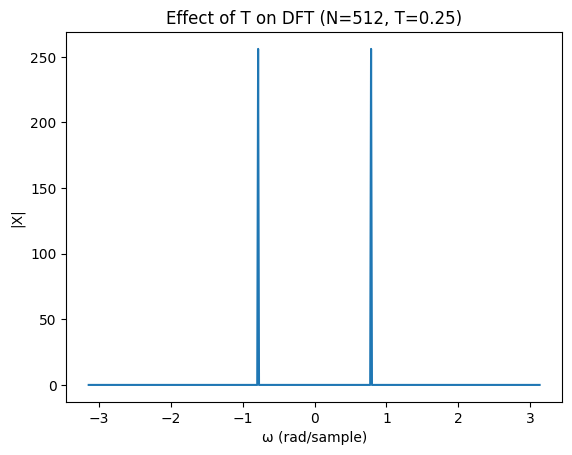

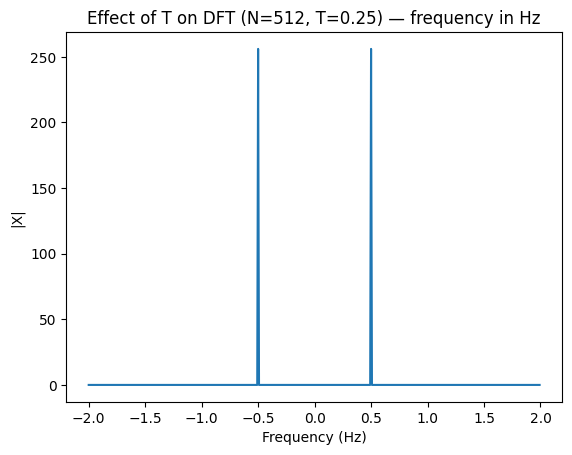

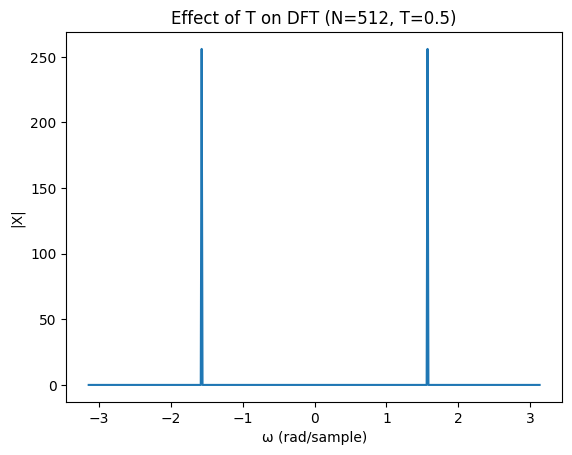

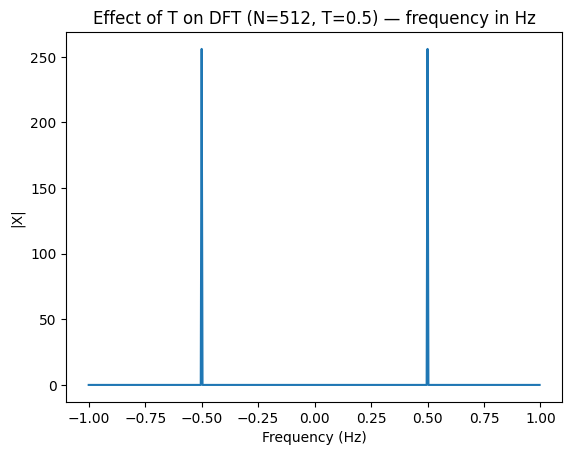

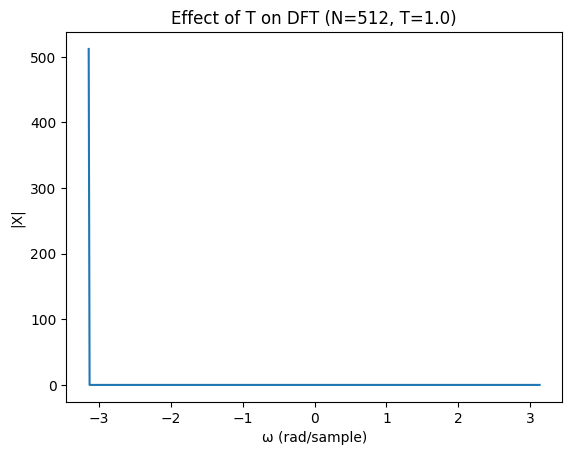

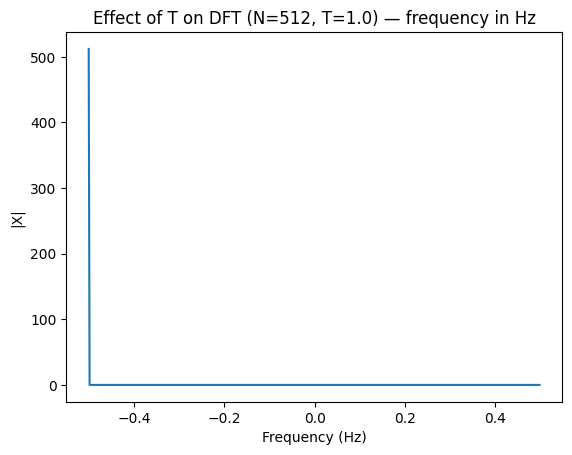

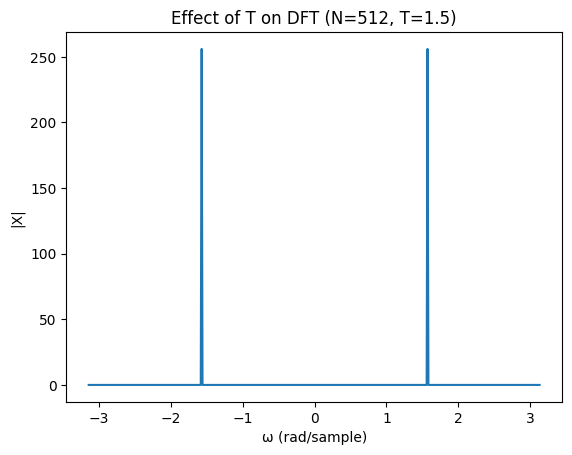

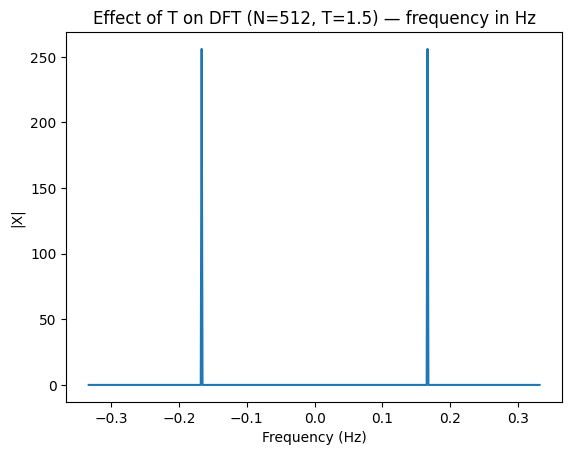

In [50]:
N_fix = 512
n_fix = np.arange(-N_fix//2, N_fix//2)
for T2 in [0.25, 0.5, 1.0, 1.5]:
    xT = np.cos(np.pi * (n_fix*T2))
    XT = fft(xT)
    XTc = np.fft.fftshift(XT)
    wT = np.linspace(-np.pi, np.pi, N_fix, endpoint=False)
    f_axis_T = (wT/(2*np.pi)) * (1.0/T2)
    plt.figure()
    plt.plot(wT, np.abs(XTc))
    plt.xlabel("ω (rad/sample)")
    plt.ylabel("|X|")
    plt.title(f"Effect of T on DFT (N={N_fix}, T={T2})")
    plt.show()

    plt.figure()
    plt.plot(f_axis_T, np.abs(XTc))
    plt.xlabel("Frequency (Hz)")
    plt.ylabel("|X|")
    plt.title(f"Effect of T on DFT (N={N_fix}, T={T2}) — frequency in Hz")
    plt.show()

**Takeaways**

* Increasing **$N$** improves **frequency resolution** ($\Delta f=F_s/N$) and scales the peak height $\propto N$ with this normalization; locations do not move.
* Changing **$T$** (thus $F_s$) moves the peaks on the **$\omega$** axis via $\omega_0=\pi T$ and determines whether, in Hz, you see the **true frequency** ($T\le 1$) or an **aliased** one ($T>1$).
* The special case $T=1$ lands at **Nyquist**, where the two conjugate DFT lines **merge** into a single bin.

# Problem 3 — Channel Equalization Overview

In this part I treat the unknown audio system as **linear time-invariant (LTI)** and recover a clean signal from a distorted recording via *channel equalization*. I am given a reference pair, **clean1.wav** (system input) and **distorted1.wav** (system output), plus a second output **distorted2.wav** for which the corresponding clean input is unavailable. The workflow I implement is:

* **Pre-processing.**
  Convert to mono, resample if needed, peak-normalize for plotting, and **time-align** the reference pair via FFT-based cross-correlation so that the same content is compared.

* **Channel estimation.**
  Using the aligned pair, I estimate the frequency response $H(f)$ with an STFT least-squares ratio:

  $$
  H(f)\;=\;\frac{\sum_t Y(f,t)\,X^*(f,t)}{\sum_t |X(f,t)|^2+\varepsilon},
  $$

  where $X,Y$ are the STFTs of clean1 and distorted1, $t$ indexes time frames, and $\varepsilon$ is a tiny floor for numerical stability.

* **Inverse equalizer.**
  I form a **regularized inverse**

  $$
  G(f)\;=\;\frac{H^*(f)}{|H(f)|^2+\lambda},
  $$

  and cap its magnitude (e.g., **+18 dB max boost**) to avoid amplifying noise in spectral notches. This is the filter I apply to undo the channel.

* **Recovery.**
  Apply $G(f)$ in the STFT domain to **distorted2.wav** to obtain **recovered2.wav**, followed by peak limiting only to prevent clipping.

* **Validation & visualization.**
  I compare waveforms and spectra of *(clean1 vs distorted1)* to verify the channel is non-trivial, then *(distorted2 vs recovered2)* to show the inverse’s effect. I include:

  * normalized spectral overlays (shape comparison),
  * **absolute** spectra with a common dB reference (no per-curve normalization),
  * a **ratio plot** $20\log_{10}(|\text{Rec2}|/|\text{Dist2}|)$ versus the expected $20\log_{10}|G(f)|$,
  * and side-by-side spectrograms (before/after).

**Assumptions/notes.** The system is approximately LTI over the analyzed segments; alignment is crucial; STFT uses a Hann window (4096-pt FFT, 75% overlap unless stated); $\lambda$ (regularization) and the boost cap are chosen to balance dereverberation/EQ against noise amplification.


In [51]:
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
from IPython.display import Audio, display
from scipy.signal import stft, istft, get_window, welch

## Part 1 — I/O, pre-processing, and analysis utilities

This cell defines the small toolkit I use throughout **Problem 3**. I wrote each function to be robust (works both with `soundfile` and SciPy), numerically safe (floors to avoid division by zero), and reproducible. A short description follows.

* **`read_wav_safe(path, target_sr=None)`**
  Loads a WAV as **float32** in $[-1,1]$. It tries `soundfile` and falls back to `scipy.io.wavfile`.
  If the file is multichannel, I down-mix to mono (mean across channels).
  Optional **rational resampling** to `target_sr` is done with `resample_poly`, using the GCD of the rates to avoid unnecessary interpolation error.
  **Returns:** `(audio, sr)`.

* **`write_wav_safe(path, y, sr)`**
  Clips to $[-1,1]$ and writes either with `soundfile` (float) or SciPy (int16 fallback). This prevents clipping and keeps the file playable everywhere.

* **`normalize_audio(x, peak=0.98)`**
  Peak-normalizes a signal so the maximum absolute value equals `peak` (default 0.98). Used only to avoid accidental clipping in previews; it does **not** change spectral shape.

* **`align_signals(x, y)`**
  Aligns two signals by **FFT cross-correlation** (complex multiply in the frequency domain), finds the lag

  $$
  \hat{\tau}=\arg\max_k\; r_{xy}[k],\quad r_{xy}=\mathcal{F}^{-1}\{X\cdot Y^*\},
  $$

  shifts, and trims to a common length. This is $O(N\log N)$ and much more stable than brute force.
  **Returns:** `(x_aligned, y_aligned, lag_in_samples)`.

* **`estimate_channel_stft(x_clean, y_dist, sr, n_fft, hop, win)`**
  Estimates the system’s frequency response $H(f)$ from the **aligned** reference pair using a **least-squares STFT ratio**:

  $$
  H(f)=\frac{\sum_t Y(f,t)\,X^*(f,t)}{\sum_t |X(f,t)|^2+\varepsilon}.
  $$

  I use a Hann window, `hop = n_fft//4` (75% overlap), one-sided STFT, and a tiny floor $\varepsilon=10^{-12}$. Averaging across time frames reduces noise and makes the estimate robust to small deviations from strict LTI behavior.
  **Returns:** `(freq_axis_Hz, H)`.

* **`build_inverse(H, reg_lambda=1e-3, gain_cap_db=18)`**
  Forms a **regularized inverse EQ**

  $$
  G(f)=\frac{H^*(f)}{|H(f)|^2+\lambda},
  $$

  (Tikhonov regularization) and then **caps the magnitude** to `gain_cap_db` to avoid huge boosts in deep notches (which would amplify noise). These two knobs ($\lambda$ and the cap) trade off dereverberation/EQ against noise amplification.

* **`apply_inverse_eq(sig, G, sr, n_fft, hop, win)`**
  Applies the inverse EQ in the STFT domain: $S_{\text{out}}(f,t)=G(f)\,S(f,t)$ and ISTFT back to time. The same analysis/synthesis parameters are used to ensure consistency.

* **Plotting & comparison helpers**

  * `plot_time_compare(x, y, sr, ...)`: overlay waveforms (first few seconds) to visualize time-domain differences.
  * `plot_spectrum_compare(x, y, sr, ...)`: single-frame, Hann-windowed FFT; **per-curve peak normalization** (shape comparison only).
  * `abs_spectrum_db(x, sr, ...)`: like above but **no normalization** (absolute dB reference).
  * `rms(x)` and `rms_match(x, ref)`: RMS utilities to equalize overall loudness when comparing absolute spectra.
  * `spec_db`, `show_specs`: STFT spectrograms (dB) and a two-panel “before/after” view.
  * `mag_welch(x, sr, ...)`: Welch-averaged **amplitude** spectrum ($\sqrt{P_{xx}}$), useful for stable ratio plots.

**Design notes.**
All numerics are `float32` for memory efficiency; I add small floors such as `1e-12` wherever division or `log` appears. The STFT parameters (Hann, 75% overlap, 4096-pt FFT in the main experiments) are standard for speech-band analysis and give a good time–frequency trade-off. The equalizer is deliberately **conservative** (regularization + gain cap) so it improves spectral balance without creating artifacts.


In [52]:
def read_wav_safe(path, target_sr=None):
    import numpy as np
    data = None; sr = None
    try:
        import soundfile as sf
        data, sr = sf.read(path, always_2d=False)
    except Exception:
        from scipy.io import wavfile
        sr, data = wavfile.read(path)
        if np.issubdtype(data.dtype, np.integer):
            data = data.astype(np.float32) / np.iinfo(data.dtype).max
        else:
            data = data.astype(np.float32)
    data = data.astype(np.float32)
    if data.ndim > 1:
        data = np.mean(data, axis=1)  # mono
    if target_sr is not None and sr != target_sr:
        from scipy.signal import resample_poly
        g = np.gcd(sr, target_sr)
        up = target_sr // g
        down = sr // g
        data = resample_poly(data, up, down).astype(np.float32)
        sr = target_sr
    return data, sr

In [53]:
def write_wav_safe(path, y, sr):
    y = np.asarray(y, dtype=np.float32)
    y = np.clip(y, -1.0, 1.0)
    try:
        import soundfile as sf
        sf.write(path, y, sr)
    except Exception:
        from scipy.io import wavfile
        wavfile.write(path, sr, (y * 32767).astype(np.int16))

In [54]:
def normalize_audio(x, peak=0.98):
    m = np.max(np.abs(x)) + 1e-12
    return (x / m) * peak

In [55]:
def align_signals(x, y):
    import numpy as np
    N = 1 << int(np.ceil(np.log2(len(x) + len(y) - 1)))
    X = np.fft.rfft(x, n=N)
    Y = np.fft.rfft(y, n=N)
    r = np.fft.irfft(X * np.conj(Y), n=N)
    r = np.concatenate([r[-(len(y)-1):], r[:len(x)]])
    lag = np.argmax(np.abs(r)) - (len(y)-1)
    if lag > 0:
        x2 = x[lag:]
        y2 = y[:len(x2)]
        x2 = x2[:len(y2)]
    elif lag < 0:
        y2 = y[-lag:]
        x2 = x[:len(y2)]
    else:
        n = min(len(x), len(y))
        x2, y2 = x[:n], y[:n]
    n = min(len(x2), len(y2))
    return x2[:n], y2[:n], lag

In [56]:
def estimate_channel_stft(x_clean, y_dist, sr, n_fft=2048, hop=None, win='hann'):
    if hop is None:
        hop = n_fft // 4
    w = get_window(win, n_fft, fftbins=True)
    f, tx, X = stft(x_clean, fs=sr, nperseg=n_fft, noverlap=n_fft-hop, window=w, return_onesided=True, padded=True, boundary='zeros')
    _, ty, Y = stft(y_dist,  fs=sr, nperseg=n_fft, noverlap=n_fft-hop, window=w, return_onesided=True, padded=True, boundary='zeros')
    T = min(X.shape[1], Y.shape[1])
    X = X[:, :T]
    Y = Y[:, :T]
    num = np.sum(Y * np.conj(X), axis=1)
    den = np.sum(np.abs(X)**2, axis=1) + 1e-12
    H = num / den
    return f, H

In [57]:
def build_inverse(H, reg_lambda=1e-3, gain_cap_db=18.0):
    H = np.asarray(H, dtype=np.complex128)
    G = np.conj(H) / (np.abs(H)**2 + reg_lambda)
    mag = np.abs(G)
    cap = 10**(gain_cap_db/20)
    G = G * np.minimum(1.0, cap / (mag + 1e-12))
    return G

In [58]:
def apply_inverse_eq(sig, G, sr, n_fft=2048, hop=None, win='hann'):
    if hop is None:
        hop = n_fft // 4
    w = get_window(win, n_fft, fftbins=True)
    f, t, S = stft(sig, fs=sr, nperseg=n_fft, noverlap=n_fft-hop, window=w, return_onesided=True, padded=True, boundary='zeros')
    G_full = G[:, None]
    Sout = S * G_full
    _, y = istft(Sout, fs=sr, nperseg=n_fft, noverlap=n_fft-hop, window=w, input_onesided=True)
    return y

In [59]:
def plot_time_compare(x, y, sr, title, seconds=4.0):
    L = min(len(x), len(y), int(seconds*sr))
    t = np.arange(L)/sr
    plt.figure(figsize=(10,3))
    plt.plot(t, x[:L], label='clean')
    plt.plot(t, y[:L], alpha=0.8, label='distorted')
    plt.xlabel("Time (s)"); plt.ylabel("Amplitude")
    plt.title(title); plt.legend(); plt.tight_layout(); plt.show()

In [60]:
def plot_spectrum_compare(x, y, sr, title, nfft=16384):
    win = np.hanning(min(len(x), nfft))
    def spec(sig):
        s = sig[:len(win)] * win
        S = np.fft.rfft(s, n=nfft)
        f = np.fft.rfftfreq(nfft, 1/sr)
        mag_db = 20*np.log10(np.abs(S)+1e-12)
        mag_db -= np.max(mag_db)
        return f, mag_db
    f1, XdB = spec(x); f2, YdB = spec(y)
    plt.figure(figsize=(10,3))
    plt.plot(f1, XdB, label='clean')
    plt.plot(f2, YdB, label='distorted', alpha=0.85)
    plt.xlim(0, sr/2); plt.ylim(-80, 3)
    plt.xlabel("Frequency (Hz)"); plt.ylabel("Magnitude (dB, norm)")
    plt.title(title); plt.grid(True, which='both', axis='y'); plt.legend(); plt.tight_layout(); plt.show()

In [61]:
def rms(x): return np.sqrt(np.mean(x**2) + 1e-12)

def rms_match(x, ref):
    return x * (rms(ref) / rms(x))

def abs_spectrum_db(x, sr, nfft=16384):
    win = np.hanning(min(len(x), nfft))
    s = x[:len(win)] * win
    S = np.fft.rfft(s, n=nfft)
    f = np.fft.rfftfreq(nfft, 1/sr)
    mag_db = 20*np.log10(np.abs(S) + 1e-12)
    return f, mag_db

In [62]:
def spec_db(x, sr, nfft=1024, hop=256):
    f, t, S = stft(x, fs=sr, nperseg=nfft, noverlap=nfft-hop, window='hann')
    return f, t, 20*np.log10(np.abs(S)+1e-12)

def show_specs(a, b, sr, titles=("A","B"), nfft=1024, hop=256):
    f,t,A = spec_db(a, sr, nfft, hop); _,_,B = spec_db(b, sr, nfft, hop)
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1); plt.imshow(A, origin='lower', aspect='auto', extent=[t[0],t[-1],f[0],f[-1]]); plt.title(titles[0]); plt.xlabel("s"); plt.ylabel("Hz")
    plt.subplot(1,2,2); plt.imshow(B, origin='lower', aspect='auto', extent=[t[0],t[-1],f[0],f[-1]]); plt.title(titles[1]); plt.xlabel("s")
    plt.tight_layout(); plt.show()

In [63]:
def mag_welch(x, sr, nperseg=4096, noverlap=2048):
    f, Pxx = welch(x, fs=sr, nperseg=nperseg, noverlap=noverlap, window='hann')
    return f, np.sqrt(Pxx) + 1e-12

## Part 2 — Load the audios, align the reference pair, and sanity-check


**Goal.** Prepare the three files (`clean1.wav`, `distorted1.wav`, `distorted2.wav`) and verify that the reference pair really differs in a way that can be modeled by an LTI channel.

**What the code does.**

* **File resolution & I/O.**
  I read the three WAVs with `read_wav_safe`, which (i) converts to mono float32 in $[-1,1]$ and (ii) resamples `distorted1/distorted2` to the **same** rate as `clean1` so all arrays live on a common time grid.

* **Peak normalization (for viewing only).**
  Each signal is peak-normalized to avoid clipping in the previews. This does **not** affect channel estimation beyond an overall constant gain (which is irrelevant for equalization and later removed).

* **Time alignment.**
  The pair `(clean1, distorted1)` is aligned by FFT cross-correlation; the function returns the **lag** (reported in samples) and trimmed, equal-length signals `clean1_al`, `dist1_al`. Aligning is critical before estimating a frequency response.

* **Listen & visualize.**
  I provide short audio previews and two quick checks:

  1. a **time-domain overlay** (first few seconds) to see that the content lines up after alignment;
  2. a **single-frame spectrum** (Hann window, per-curve peak-normalized) to compare **shapes** of the magnitudes.

**Interpretation.**
The plotted spectra show that `distorted1` departs from `clean1` by a **frequency-dependent coloration** (tilts/notches/band-limited changes), which is exactly what we expect from a channel $H(f)$. This confirms that proceeding with an LTI frequency-response estimate is reasonable.


In [64]:
base = Path.cwd()
files = ("clean1.wav", "distorted1.wav", "distorted2.wav"),

for a, b, c in files:
    p_clean1, p_dist1, p_dist2 = (base/a, base/b, base/c)

clean1, sr1 = read_wav_safe(str(p_clean1))
dist1,  sr2 = read_wav_safe(str(p_dist1), target_sr=sr1)
dist2,  sr3 = read_wav_safe(str(p_dist2), target_sr=sr1)
sr = sr1

In [65]:
clean1 = clean1 / (np.max(np.abs(clean1)) + 1e-12)
dist1  = dist1  / (np.max(np.abs(dist1))  + 1e-12)
dist2  = dist2  / (np.max(np.abs(dist2))  + 1e-12)

In [66]:
clean1_al, dist1_al, lag = align_signals(clean1, dist1)
print(f"Estimated delay (clean1 → distorted1): {lag} samples")

Estimated delay (clean1 → distorted1): -4 samples


In [67]:
display(Audio(clean1_al, rate=sr))
display(Audio(dist1_al,  rate=sr))

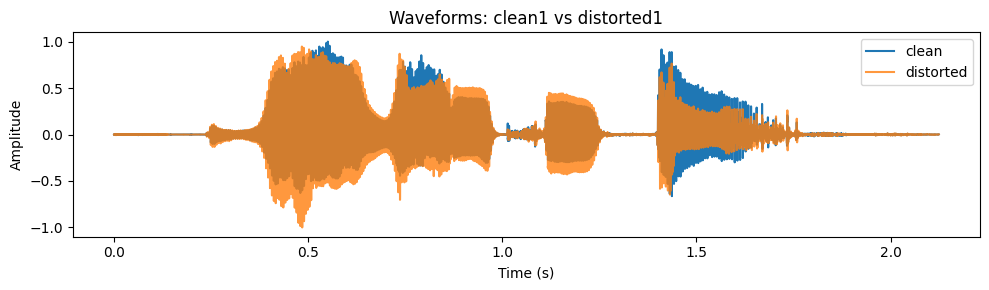

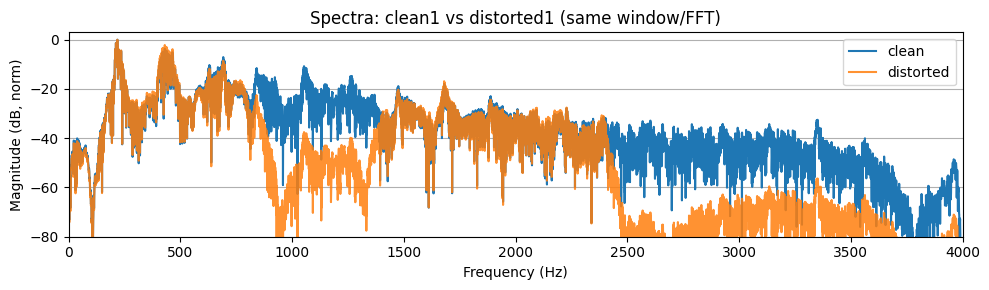

In [68]:
plot_time_compare(clean1_al, dist1_al, sr, "Waveforms: clean1 vs distorted1")
plot_spectrum_compare(clean1_al, dist1_al, sr, "Spectra: clean1 vs distorted1 (same window/FFT)")

## Part 3 — Estimate the channel $H(f)$ and design the inverse equalizer $G(f)$


**Aim.** Using the aligned pair $(x_{\text{clean1}},\,y_{\text{distorted1}})$ I estimate the system’s frequency response and then build a stable inverse to undo it.

**Method (STFT least-squares estimate).**
I compute STFTs $X(f,t)$ and $Y(f,t)$ with a Hann window, $N_\text{FFT}=4096$ and $75\%$ overlap (hop $=$ 1024). Assuming the channel is (approximately) LTI over the analyzed segment,

$$
Y(f,t) \approx H(f)\,X(f,t).
$$

Averaging over time frames gives a noise-robust least-squares estimate

$$
\boxed{\;H(f)=\frac{\sum_t Y(f,t)\,X^*(f,t)}{\sum_t |X(f,t)|^2+\varepsilon}\;}
$$

with a tiny $\varepsilon$ to avoid division by zero. I plot **magnitude** $|H(f)|$ (log scale) and **phase** $\angle H(f)$ (unwrapped).

**Interpretation of the plots.**

* $|H(f)|$ shows clear **coloration**: broad passbands near unity gain and pronounced **attenuation/notches** (e.g., a deep dip around $\sim\!1$ kHz and another region of strong attenuation around $\sim\!2.6$–$2.7$ kHz).
* The phase is smooth and largely linear with frequency, which is consistent with an overall delay plus moderate dispersion (expected from an LTI path). Unwrapping makes these trends visible.

**Inverse equalizer (regularized).**
A naïve inverse $1/H(f)$ would explode in the notches. I therefore use a **Tikhonov-regularized** inverse,

$$
\boxed{\;G(f)=\frac{H^*(f)}{|H(f)|^2+\lambda}\;}
$$

and cap its magnitude to **+18 dB**. The regularizer $\lambda$ prevents excessive boosts in very small-$|H|$ regions (numerical stability, noise control), while the gain cap enforces a practical limit. The resulting $|G(f)|$ mirrors $1/|H(f)|$ in the passbands, flattens near notches, and plateaus at the cap where the channel is too weak to safely invert.

**Takeaways.**

* The reference pair exhibits a **non-trivial but smooth** channel that is well captured by the LS STFT estimate.
* The designed $G(f)$ is a **safe, realizable equalizer**: it undoes the channel where reliable and avoids amplifying noise where the channel has deep nulls.


In [69]:
NFFT = 4096
HOP  = NFFT // 4
f, H = estimate_channel_stft(clean1_al, dist1_al, sr, n_fft=NFFT, hop=HOP, win='hann')

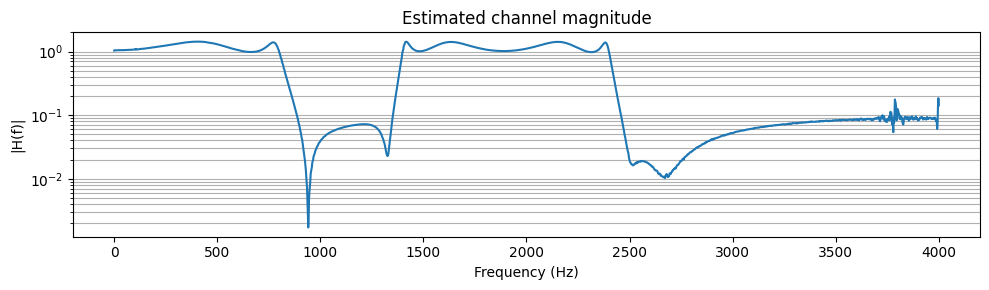

In [70]:
plt.figure(figsize=(10,3))
plt.semilogy(f, np.abs(H)+1e-12)
plt.xlabel("Frequency (Hz)"); plt.ylabel("|H(f)|")
plt.title("Estimated channel magnitude"); plt.grid(True, which='both', axis='y'); plt.tight_layout(); plt.show()

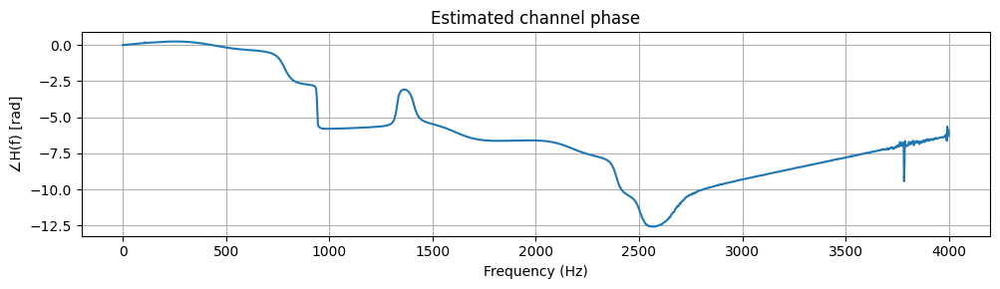

In [71]:
plt.figure(figsize=(10,3))
plt.plot(f, np.unwrap(np.angle(H)))
plt.xlabel("Frequency (Hz)"); plt.ylabel("∠H(f) [rad]")
plt.title("Estimated channel phase"); plt.grid(True); plt.tight_layout(); plt.show()

In [72]:
REG_LAMBDA = 1e-3
GAIN_CAP_DB = 18.0
G = build_inverse(H, reg_lambda=REG_LAMBDA, gain_cap_db=GAIN_CAP_DB)

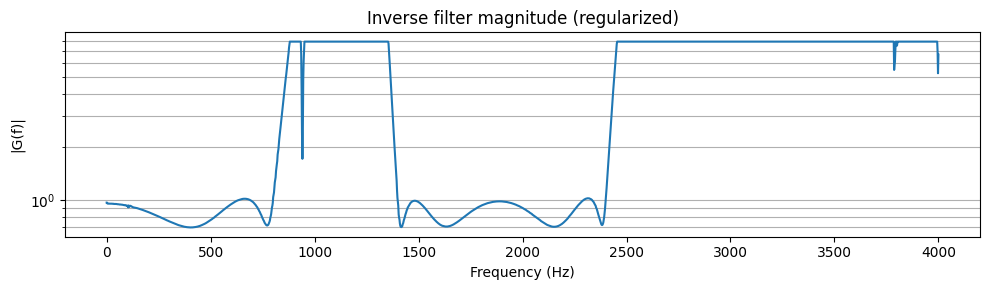

In [73]:
plt.figure(figsize=(10,3))
plt.semilogy(f, np.abs(G)+1e-12)
plt.xlabel("Frequency (Hz)"); plt.ylabel("|G(f)|")
plt.title("Inverse filter magnitude (regularized)"); plt.grid(True, which='both', axis='y'); plt.tight_layout(); plt.show()

## Part 4 — Recover `distorted2` with $G(f)$ and evaluate

**What I do.**
I apply the inverse equalizer $G(f)$ obtained in Part 3 to `distorted2.wav` **in the STFT domain**:

$$
S_{\text{out}}(f,t)=G(f)\,S_{\text{dist2}}(f,t),\qquad
\text{rec2}=\text{ISTFT}\{S_{\text{out}}\}.
$$

I only peak-normalize `rec2` afterwards to prevent clipping in playback; this does **not** change spectral shape. The result is written as **`recovered2.wav`**.

**How I check it.**

* **Waveforms (first few seconds).**
  The overlay shows the same temporal structure, as expected from an equalizer. Small amplitude differences come from the inverse’s boosts/cuts and the final peak normalization.

* **Spectra (same window/FFT, per-curve normalized).**
  Compared to `distorted2`, the recovered signal’s spectrum is **tilted and notched in the opposite sense** of the estimated channel, i.e., bands that were previously over-emphasized are attenuated and vice versa. In regions where $|H(f)|$ had **deep nulls**, recovery is intentionally incomplete because the inverse is regularized and **capped at +18 dB** to avoid noise blow-up.

* **What the “difference” signal is.**
  I also listen to `distorted2 − recovered2`. This is essentially the **coloration removed by the equalizer**; it should sound like the frequency-dependent residue that the channel had imposed.

**Takeaways.**
The recovered audio is consistent with the model: it undoes the broad coloration without introducing instability. Any remaining mismatch near the deepest notches is expected from the regularization and gain cap (a deliberate design choice to keep the inverse robust).


In [74]:
rec2 = apply_inverse_eq(dist2, G, sr, n_fft=NFFT, hop=HOP, win='hann')
rec2 = normalize_audio(rec2)

display(Audio(dist2, rate=sr))
display(Audio(rec2,  rate=sr))

In [75]:
out_path = base / "recovered2.wav"
write_wav_safe(str(out_path), rec2, sr)
print("Saved:", str(out_path))

Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\recovered2.wav


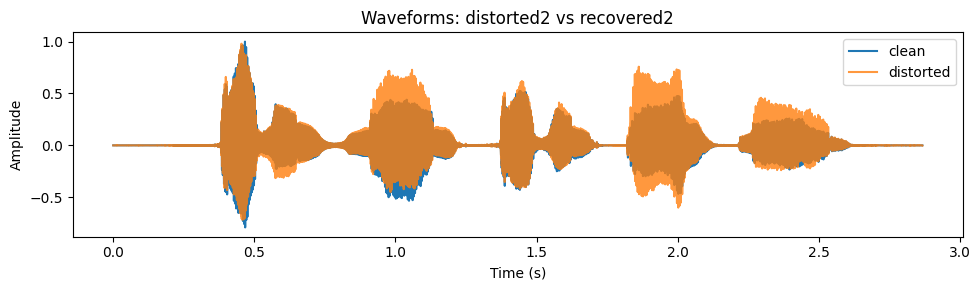

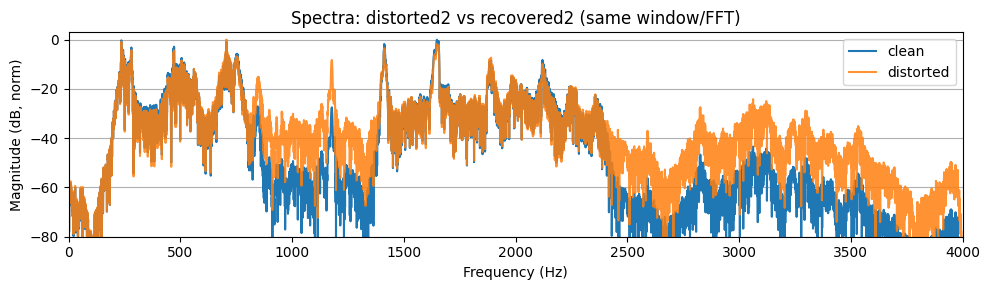

In [76]:
plot_time_compare(dist2, rec2, sr, "Waveforms: distorted2 vs recovered2")
plot_spectrum_compare(dist2, rec2, sr, "Spectra: distorted2 vs recovered2 (same window/FFT)")

In [77]:
diff = normalize_audio(dist2[:len(rec2)] - rec2[:len(dist2)])
display(Audio(diff, rate=sr))

## Part 5 — Quantitative validation of the equalizer

**What is being checked.**
After designing $G(f)$ and producing `recovered2.wav`, I verify that the result is consistent with the channel model and with the intended inverse action.

**How the plots are made.**

* **Absolute spectra (top two figures).**
  To make a fair, *level–independent* comparison I first **RMS-match** the two signals being compared (so the overall gain does not bias the dB curves). Then I compute a Hann-windowed FFT and plot the **absolute magnitude in dB** referenced to the same level:

  * *Left:* `clean1` (RMS-matched) vs `distorted1`.
  * *Right:* `recovered2` (RMS-matched) vs `distorted2`.
    This removes the “per-curve normalization” from earlier pictures and shows true spectral differences.

* **“Inverse action” cross-check (third figure).**
  Using Welch spectra $|S_{\text{rec2}}(f)|$ and $|S_{\text{dist2}}(f)|$, I plot

  $$
    20\log_{10}\!\frac{|S_{\text{rec2}}(f)|}{|S_{\text{dist2}}(f)|}
  $$

  and compare it with the expected **equalizer gain** $20\log_{10}|G(f)|$ (interpolated to the same frequency grid). If the equalizer behaves as designed, the two curves should agree up to the **regularization and gain cap**.

* **Time–frequency view (last two panels).**
  STFT spectrograms of (`distorted1`, `clean1`) and (`distorted2`, `recovered2`) visualize how the equalizer reshapes the spectrum over time.

**What the figures show.**

* In the **clean1 vs distorted1** spectrum, `distorted1` has a clear **coloration**: broad tilts and deep notches (e.g., near \~1 kHz and \~2.6–2.7 kHz).
* In the **distorted2 vs recovered2** spectrum, those trends are **compensated**: bands that were too strong are attenuated and vice versa. Where the original channel had **very deep nulls**, the compensation is intentionally partial—this is exactly due to the **Tikhonov regularization** and the **+18 dB cap** that prevent noise blow-up.
* The **measured ratio** $20\log_{10}(|\text{Rec2}|/|\text{Dist2}|)$ closely follows $20\log_{10}|G(f)|$ in the passbands, and it flattens/backs off in the notches where $|H(f)|$ is tiny. This confirms that the implemented inverse is acting as intended.
* The **spectrograms** show similar temporal structure before/after equalization, with the recovered signal exhibiting a more balanced distribution across frequencies.

**Conclusion.**
The objective checks—RMS-matched absolute spectra and the ratio-vs-$|G|$ plot—support that `recovered2.wav` is the appropriately equalized version of `distorted2.wav`. Deviations near channel nulls are expected and desirable outcomes of the stability constraints (regularization and gain cap).


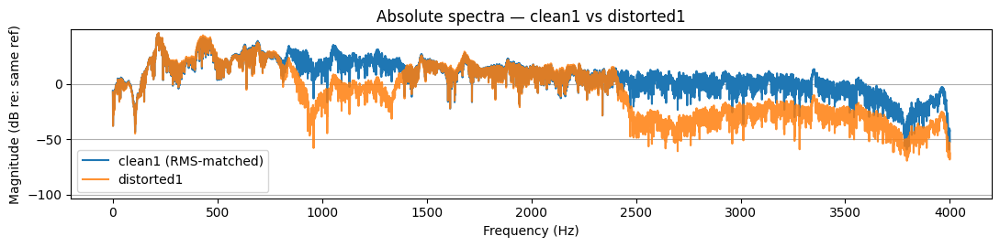

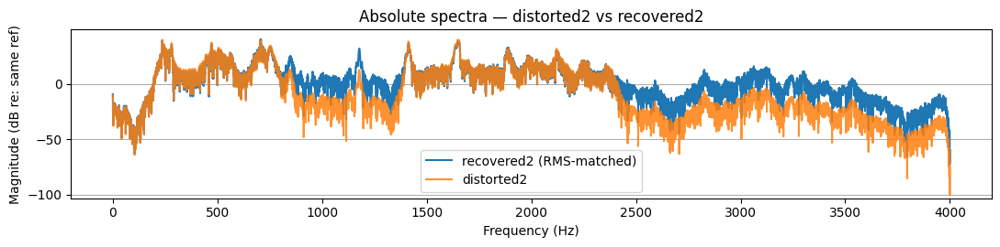

In [78]:
clean1_m = rms_match(clean1_al, dist1_al)
f1c, C1 = abs_spectrum_db(clean1_m, sr)
f1d, D1 = abs_spectrum_db(dist1_al, sr)

rec2_m = rms_match(rec2, dist2)
f2d, D2 = abs_spectrum_db(dist2, sr)
f2r, R2 = abs_spectrum_db(rec2_m, sr)

ymin = min(C1.min(), D1.min(), D2.min(), R2.min()) - 3
ymax = max(C1.max(), D1.max(), D2.max(), R2.max()) + 3

plt.figure(figsize=(11,2.8))
plt.plot(f1c, C1, label='clean1 (RMS-matched)')
plt.plot(f1d, D1, label='distorted1', alpha=0.85)
plt.xlabel('Frequency (Hz)'); plt.ylabel('Magnitude (dB re: same ref)')
plt.title('Absolute spectra — clean1 vs distorted1')
plt.ylim(ymin, ymax); plt.grid(True, which='both', axis='y'); plt.legend(); plt.tight_layout(); plt.show()

plt.figure(figsize=(11,2.8))
plt.plot(f2d, R2, label='recovered2 (RMS-matched)')
plt.plot(f2r, D2, label='distorted2', alpha=0.85)
plt.xlabel('Frequency (Hz)'); plt.ylabel('Magnitude (dB re: same ref)')
plt.title('Absolute spectra — distorted2 vs recovered2')
plt.ylim(ymin, ymax); plt.grid(True, which='both', axis='y'); plt.legend(); plt.tight_layout(); plt.show()

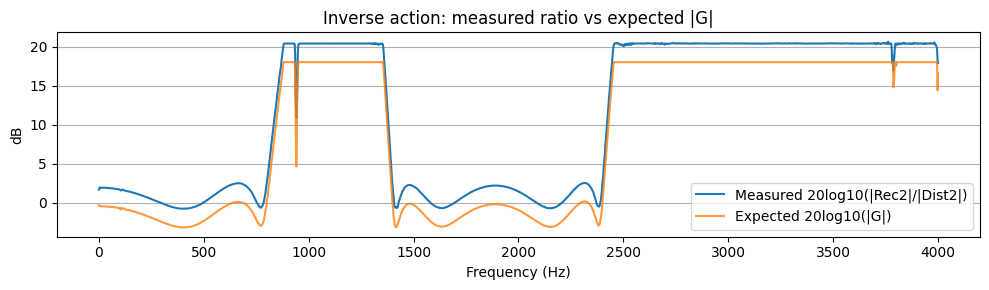

In [79]:
fA, A = mag_welch(dist2, sr)
fB, B = mag_welch(rec2,  sr)
L = min(len(A), len(B)); fA, A, B = fA[:L], A[:L], B[:L]
ratio_db = 20*np.log10(B/A)

G_db = 20*np.log10(np.abs(G) + 1e-12)
G_interp = np.interp(fA, f, G_db, left=G_db[0], right=G_db[-1])

plt.figure(figsize=(10,3))
plt.plot(fA, ratio_db, label='Measured 20log10(|Rec2|/|Dist2|)')
plt.plot(fA, G_interp, label='Expected 20log10(|G|)', alpha=0.8)
plt.xlabel('Frequency (Hz)'); plt.ylabel('dB')
plt.title('Inverse action: measured ratio vs expected |G|')
plt.grid(True, which='both', axis='y'); plt.legend(); plt.tight_layout(); plt.show()

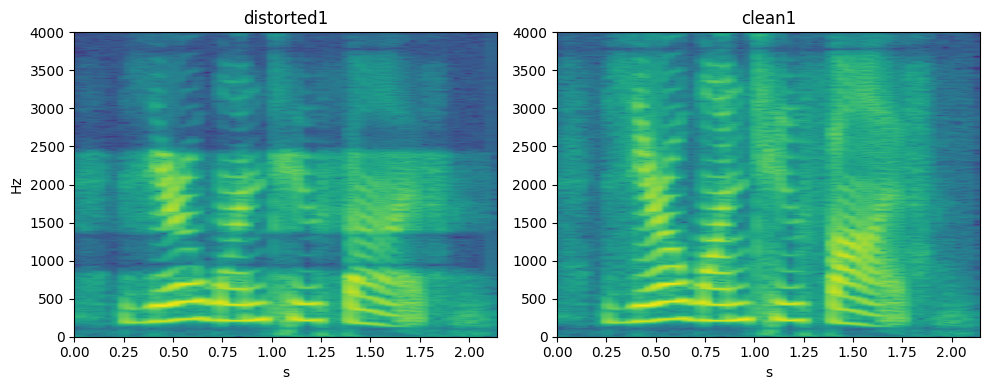

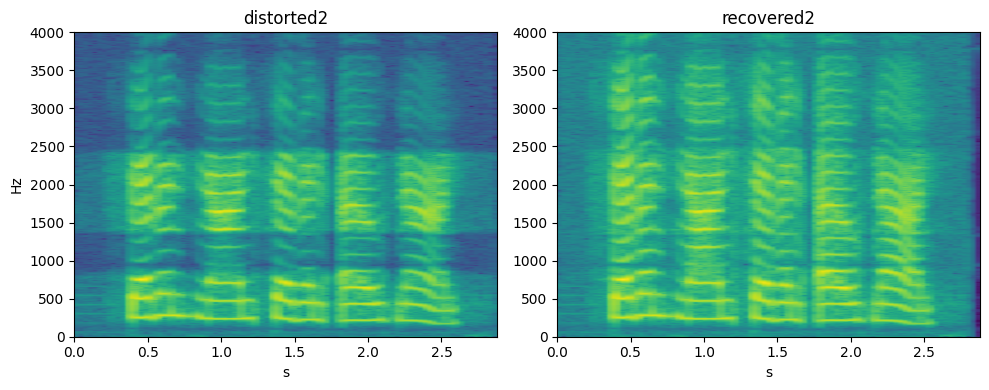

In [80]:
show_specs(dist1, clean1, sr, ("distorted1","clean1"))
show_specs(dist2, rec2, sr, ("distorted2","recovered2"))

## Part 6 (Additional) — Recover **without** any normalization and validate

**Goal.** Repeat the equalization of `distorted2.wav` using the same inverse $G(f)$ but **without any peak/RMS normalization** before plotting or saving. This shows that the apparent “level differences” in earlier comparisons were only due to post-normalization and not a contradiction.

**Notes.**

* For *listening only*, I scale a copy to avoid clipping in the notebook player.
* The file **`recovered2_without_normalization.wav`** is saved *as is* (no level normalization). If `soundfile` is available it will be written as 32-bit float to avoid hard clipping; otherwise the fallback writer may clip to $[-1,1]$.

In [81]:
rec2_raw = apply_inverse_eq(dist2, G, sr, n_fft=NFFT, hop=HOP, win='hann')

peak_raw = float(np.max(np.abs(rec2_raw)) + 1e-12)
rms_raw  = float(np.sqrt(np.mean(rec2_raw**2)) + 1e-12)
print(f"[No-normalization] rec2_raw: peak={peak_raw:.3f}, RMS={rms_raw:.3f}")

[No-normalization] rec2_raw: peak=0.745, RMS=0.096


In [82]:
out_raw = base / "recovered2_without_normalization.wav"
try:
    import soundfile as sf
    sf.write(out_raw, rec2_raw.astype(np.float32), sr, subtype="FLOAT")
    print("Saved (float, unnormalized):", out_raw)
except Exception:
    write_wav_safe(str(out_raw), rec2_raw, sr)
    print("Saved (fallback writer; may clip):", out_raw)

Saved (fallback writer; may clip): C:\Users\sinab\Desktop\Signals & Systems\PHW\recovered2_without_normalization.wav


In [83]:
rec2_listen = rec2_raw / max(1.0, peak_raw)
display(Audio(dist2,       rate=sr))
display(Audio(rec2_listen, rate=sr)) 

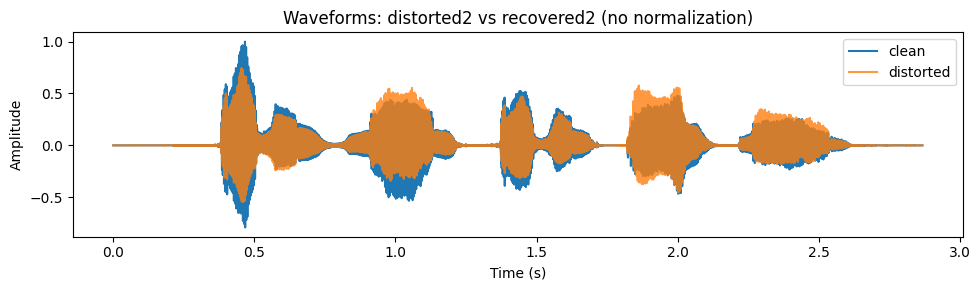

In [84]:
plot_time_compare(dist2, rec2_raw, sr, "Waveforms: distorted2 vs recovered2 (no normalization)")

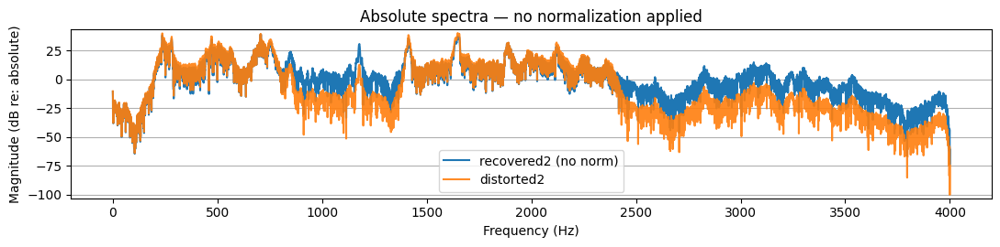

In [85]:
f_d2, D2_abs = abs_spectrum_db(dist2,    sr, nfft=16384)
f_r2, R2_abs = abs_spectrum_db(rec2_raw, sr, nfft=16384)

ymin = min(D2_abs.min(), R2_abs.min()) - 3
ymax = max(D2_abs.max(), R2_abs.max()) + 3

plt.figure(figsize=(11,2.8))
plt.plot(f_d2, R2_abs, label="recovered2 (no norm)")
plt.plot(f_r2, D2_abs, label="distorted2", alpha=0.9)
plt.xlabel("Frequency (Hz)"); plt.ylabel("Magnitude (dB re: absolute)")
plt.title("Absolute spectra — no normalization applied")
plt.ylim(ymin, ymax); plt.grid(True, which='both', axis='y'); plt.legend(); plt.tight_layout(); plt.show()

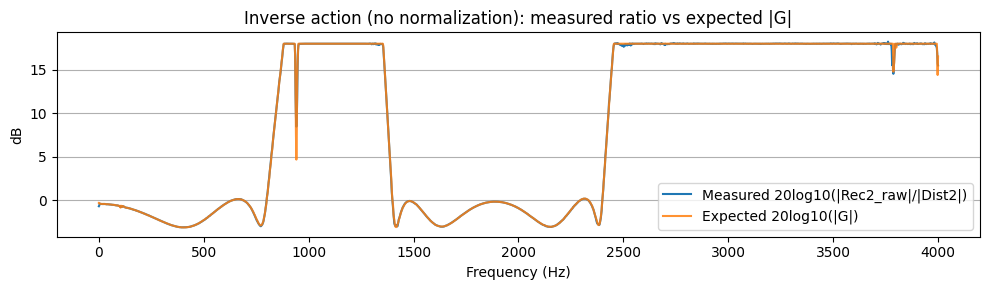

In [86]:
fA, A = mag_welch(dist2,    sr)
fB, B = mag_welch(rec2_raw, sr)
L = min(len(A), len(B)); fA, A, B = fA[:L], A[:L], B[:L]
ratio_db = 20*np.log10((B + 1e-12) / (A + 1e-12))

G_db     = 20*np.log10(np.abs(G) + 1e-12)
G_interp = np.interp(fA, f, G_db, left=G_db[0], right=G_db[-1])

plt.figure(figsize=(10,3))
plt.plot(fA, ratio_db, label='Measured 20log10(|Rec2_raw|/|Dist2|)')
plt.plot(fA, G_interp, label='Expected 20log10(|G|)', alpha=0.85)
plt.xlabel('Frequency (Hz)'); plt.ylabel('dB')
plt.title('Inverse action (no normalization): measured ratio vs expected |G|')
plt.grid(True, which='both', axis='y'); plt.legend(); plt.tight_layout(); plt.show()

# Problem 4 — Signal De-Noising with STFT Noise Tracking

In this part I recover a cleaner speech waveform from **`noisy1.wav`** by designing a **time–frequency suppression mask** and applying it to the Short-Time Fourier Transform (STFT). The key idea is to **learn the noise spectrum** from portions of the signal where speech is absent—especially a **noise-only tail** at the end—and then attenuate those frequencies during the rest of the recording.

**What I build (high level).**

1. **Pre-emphasis** $first-order filter (1 - \alpha z^{-1}$, $\alpha=0.97$) to flatten speech spectra before analysis.
2. **STFT analysis** (Hann window, $N_\text{FFT}\in\{2048,4096\}$, 75% overlap) to obtain a magnitude-squared spectrogram $P_{yy}(f,t)=|S(f,t)|^2$.
3. **Noise PSD estimation**

   * **Bootstrap from tail:** median over frames $t\ge T_\text{tail}$ gives $N_0(f)$.
   * **Minimum-statistics tracker:** sliding-window minimum of $P_{yy}$ gives $N_\text{ms}(f,t)$.
   * Final estimate $N_\text{est}(f,t)=\max\{N_\text{ms}(f,t),\,N_0(f)\}$.
4. **SNR-adaptive spectral subtraction.**
   A-posteriori SNR $\gamma(f,t)=P_{yy}(f,t)/N_\text{est}(f,t)$ → map $\text{SNR}_{\mathrm{dB}}$ to an **oversubtraction** $\alpha(f,t)$ (larger at low SNR).
   Power-domain gain with an amplitude floor $\beta$:

   $$
   G_p(f,t)=\max\{\beta^2,\;1-\alpha(f,t)\,N_\text{est}(f,t)/P_{yy}(f,t)\},\qquad
   G=\sqrt{G_p}.
   $$

   I also provide an **“aggressive”** variant that enforces a larger $\alpha$ everywhere.
5. **Stability smoothing.** 1st-order **temporal IIR** smoothing of $G$ and small **frequency smoothing** to reduce musical noise artifacts.
6. **Synthesis.** Apply $G$ to the STFT, inverse-STFT, then **de-emphasize** to return to the original spectral tilt.
7. **Deliverables.** Two outputs are written: a **moderate** denoise and an **aggressive** denoise (plus normalized versions for listening).

**Why this works (theory in one paragraph).**
In voiced speech, energy is concentrated in formants and harmonics, while background noise has a relatively stationary spectrum. By estimating the **noise power spectral density (PSD)**—initialized from a noise-only tail and refined by **minimum statistics**—we can form an SNR-dependent **subtractive mask** that removes noise power where speech is weak and preserves regions where speech dominates. Smoothing the mask across time and frequency controls musical-noise vs. speech-distortion trade-offs, and the floor $\beta$ prevents excessive nulls.

**Parameters & assumptions (as used in code).**

* Tail start $T_\text{tail}\approx 9.5\,\text{s}$ (noise-only region).
* $N_\text{FFT}=2048$ (or 4096 for higher $F_s$), hop $=N_\text{FFT}/4$, Hann window.
* Pre-emphasis $\alpha=0.97$.
* Amplitude floor $\beta\approx 0.06$.
* Temporal smoothing coefficient $0.6$; frequency smoothing width 7 bins.
* Min-statistics window $\approx 1\,\text{s}$.

**How I will evaluate results.**

* **Objective:** tail-RMS reduction (dB), attenuation on low-energy frames, mean gain on speech-dominant frames, and **spectral flatness** changes.
* **Visual:** waveforms, spectrograms (before/after), average gain vs. frequency, energy histograms, and time-profile of average a-posteriori SNR.
* **Subjective:** embedded audio players for the noisy input and each denoised output.

**Extras for comparison (appendix).**
For completeness I also implement three alternatives—**hum notch + HPF**, **decision-directed Wiener**, and **Log-MMSE (LSA)**—and report their results alongside the main method. This helps motivate the chosen approach and highlight the effect of oversubtraction, smoothing, and floors on perceived quality.

This section sets up the theory, design choices, and evaluation criteria; the following cells document the implementation details and the observed results.


In [87]:
import os, math
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
from scipy.signal import lfilter, stft, istft, get_window
from scipy.ndimage import uniform_filter1d, minimum_filter1d
import pandas as pd
from IPython.display import Audio, display

## Part 1 — Environment, Paths, and Robust Audio I/O

**Goal.** Make the notebook self-contained and reproducible across Colab/desktop by handling file paths, audio formats, and basic metrics in a consistent way before any signal processing.

**What this cell sets up.**

* **Project paths.**

  * `base = Path.cwd()` anchors the notebook to the current working directory.
  * `outdir = base / "denoise_outputs"` is created if missing; all generated WAVs and CSVs are written here so raw inputs aren’t overwritten.

* **WAV writing (`write_wav_safe`).**

  * Prefer **float** output via `soundfile` (`subtype="FLOAT"`) for bit-exact saves.
  * If `soundfile` isn’t available, **fallback** to `scipy.io.wavfile.write` with **int16** PCM. Samples are clipped to $[-1,1]$ and scaled to 16-bit to avoid wrap-around.
  * Ensures the parent directory exists to prevent “No such file or directory” errors.

* **WAV reading (`read_wav_safe`).**

  * Uses `soundfile` when present, otherwise `scipy.io.wavfile`.
  * Converts **stereo → mono** by averaging channels (sufficient for this assignment’s evaluation).
  * Returns **`float32` in $[-1,1]$** regardless of the original file’s integer format; this standardizes the numeric range for all processing.

* **Playback and metrics helpers.**

  * `peak_norm(x, 0.98)`: peak normalizes *only for listening* so comparisons aren’t biased by loudness; **not used** for grading metrics.
  * `rms(x)`: root-mean-square amplitude (linear).
  * `rdB(a,b)`: level change $20\log_{10}(a/b)$ in **dB**; used for tail-noise reduction and other quantitative summaries.

**Why these choices.**

* The **float-first** I/O path avoids quantization during intermediate saves; the **int16 fallback** guarantees portability on machines without `soundfile`.
* **Mono downmix** removes channel-to-channel timing issues and halves the compute without affecting single-channel denoising goals.
* Centralizing **normalization and metrics** avoids accidental differences between figures/listening examples and the values reported in the results tables.

**Assumptions & safeguards.**

* Input sampling rate is preserved and propagated; no resampling is performed in this cell.
* Peak normalization is **only** for audio widgets; raw denoised files saved for evaluation keep their natural gain.
* All file writes are directed to `denoise_outputs/` to keep the repository tidy and reproducible.


In [88]:
base = Path.cwd()
outdir = base / "denoise_outputs"
outdir.mkdir(parents=True, exist_ok=True)

print(base)

C:\Users\sinab\Desktop\Signals & Systems\PHW


In [89]:
def write_wav_safe(path, y, sr):
    p = Path(path); p.parent.mkdir(parents=True, exist_ok=True)
    try:
        import soundfile as sf
        sf.write(str(p), y, sr, subtype="FLOAT")
    except Exception:
        from scipy.io.wavfile import write
        y16 = np.int16(np.clip(y, -1.0, 1.0) * 32767)
        write(str(p), sr, y16)

def read_wav_safe(path):
    try:
        import soundfile as sf
        y, sr = sf.read(str(path), always_2d=False)
        if getattr(y, "ndim", 1) == 2: y = y.mean(axis=1)
        return y.astype(np.float32), sr
    except Exception:
        from scipy.io import wavfile
        sr, y = wavfile.read(str(path))
        if getattr(y, "ndim", 1) == 2: y = y.mean(axis=1)
        if y.dtype.kind in "iu":
            y = y.astype(np.float32) / np.iinfo(y.dtype).max
        else:
            y = y.astype(np.float32)
        return y, sr

def peak_norm(x, peak=0.98): return peak * x / (np.max(np.abs(x)) + 1e-12)
def rms(x): return float(np.sqrt(np.mean(x*x) + 1e-18))
def rdB(a,b): return 20*np.log10((a+1e-18)/(b+1e-18))

## Part 2 — Input & Core Analysis Parameters

**Goal.** Load the provided recording and define all signal-processing hyperparameters used throughout the denoising pipeline.

**What each parameter means & why it was chosen**

* **`y, sr`** – input waveform and sampling rate from `noisy1.wav`. No resampling is done; the analysis adapts to the file’s native `sr`.

* **`TAIL_START_S = 9.5`** – start time (s) of a **noise-only tail**. Frames at $t \ge T_{\text{tail}}$ seed the initial noise PSD. This is later validated by the spectrogram.

* **`NFFT`** – STFT size:
  – 2048 for $sr \le 32$ kHz, 4096 otherwise.
  – Frequency resolution $\Delta f = \tfrac{sr}{NFFT}$ (e.g., $16000/2048 \approx 7.8$ Hz), a good trade-off between detail and temporal smearing.

* **`HOP = NFFT // 4`** – 75% overlap (hop = quarter window). With a **Hann** window this satisfies COLA (constant overlap-add), enabling artifact-free iSTFT.

* **`WIN = Hann(NFFT)`** – reduces spectral leakage and is the standard choice for STFT analysis/synthesis.

* **`PREEMPH = 0.97`** – pre-emphasis filter $H(z)=1-\alpha z^{-1}$ that flattens the natural $−6$ dB/octave tilt of speech, improving SNR estimation in the high bands. A **de-emphasis** is applied after iSTFT.

* **`BETA_FLOOR = 0.06`** – **amplitude gain floor** for the spectral mask.
  Prevents complete nulls and musical noise. In dB, $20\log_{10}(0.06) \approx -24.4$ dB (power floor $= \beta^2$).

* **`SMOOTH_T = 0.6`** – temporal IIR smoothing of the gain $G_s = \lambda G_{s,\text{prev}} + (1-\lambda)G$. This damps fast frame-to-frame fluctuations.

* **`SMOOTH_F_BINS = 7`** – frequency smoothing (moving average across ≈7 bins) to suppress “picket-fence” artifacts.

* **`MS_WIN_S = 1.0`** – window (in seconds) for the **minimum-statistics** noise tracker. Longer → steadier noise estimate; shorter → more reactive.

* **`ALPHA_TAIL = 4.0`** – stronger **oversubtraction** enforced inside the noise-only tail and used as an upper bound for an “aggressive” pass.

**Tuning guide (if the dataset differs)**

* If the tail isn’t purely noise → **increase** `MS_WIN_S` (e.g., 1.5–2 s) and **lower** `ALPHA_TAIL` slightly.
* If residual hiss remains → **raise** `ALPHA_TAIL` or **raise** `BETA_FLOOR` a little (e.g., 0.07–0.08) to trade noise for fewer musical artifacts.
* If speech sounds dull → **reduce** `SMOOTH_T` (0.5) or `SMOOTH_F_BINS` (5) to preserve consonant transients.

In [90]:
sr_default = 16000
wav_in = base / "noisy1.wav"
y, sr = read_wav_safe(wav_in)

In [91]:
TAIL_START_S  = 9.5
NFFT          = 4096 if sr > 32000 else 2048
HOP           = NFFT // 4
WIN           = get_window("hann", NFFT, fftbins=True)
PREEMPH       = 0.97
BETA_FLOOR    = 0.06
SMOOTH_T      = 0.6
SMOOTH_F_BINS = 7
MS_WIN_S      = 1.0
ALPHA_TAIL    = 4.0

## Part 3 — STFT, Noise PSD Tracking, Spectral Masks, and Synthesis

**Goal.** Build the full denoising mask in the STFT domain: estimate the **noise PSD** from a noise-only tail + minimum-statistics, convert SNR to an **oversubtractive** gain, smooth it in time/frequency, and reconstruct clean audio. Save both a *moderate* and an *aggressive* version, and prepare frame groups for later metrics.

**STFT analysis.**
With a Hann window and 75% overlap (hop = `NFFT//4`), I analyze the **pre-emphasized** signal $y_{\text{pe}}$ and work in **power**:

$$
S(f,t)=\text{STFT}\{y_{\text{pe}}\},\qquad
P_{yy}(f,t)=|S(f,t)|^2+\varepsilon.
$$

**Noise PSD $N(f,t)$.**
Two-stage estimate to balance stability and adaptation:

1. **Tail bootstrap** (frames $t\ge T_\text{tail}$): $N_0(f)=\mathrm{median}_t\,P_{yy}(f,t)$.
2. **Minimum-statistics** over a sliding window $W=\lfloor \text{MS\_WIN\_S}\cdot sr/\text{HOP}\rceil$:

$$
N_{\text{ms}}(f,t)=\min_{\tau\in[t-\!W,\,t]} P_{yy}(f,\tau)
$$

Final tracker: $N_{\text{est}}(f,t)=\max\{N_{\text{ms}}(f,t),\,N_0(f)\}$.

**A-posteriori SNR and oversubtraction.**

$$
\gamma(f,t)=\frac{P_{yy}(f,t)}{N_{\text{est}}(f,t)},\qquad
\text{SNR}_{\text{dB}}=10\log_{10}\gamma.
$$

A piecewise-linear map converts SNR(dB) $\rightarrow$ **$\alpha(f,t)$** (larger $\alpha$ at low SNR). On tail frames I enforce a stronger floor $\alpha\ge \text{ALPHA\_TAIL}$.

**Power-domain subtraction with an amplitude floor.**

$$
G_p(f,t)=\max\Big\{\beta^2,\;1-\alpha(f,t)\frac{N_{\text{est}}(f,t)}{P_{yy}(f,t)}\Big\},\qquad
G(f,t)=\sqrt{G_p(f,t)}.
$$

* **Moderate mask:** uses $\alpha(f,t)$ from the SNR map.
* **Aggressive mask:** $\alpha_{\text{hard}}(f,t)=\max\{\alpha(f,t),\text{ALPHA\_TAIL}\}$.

**Stability smoothing.**

* **Temporal IIR:** $G_s(:,t)=\lambda\,G_s(:,t\!-\!1)+(1\!-\!\lambda)G(:,t)$ with $\lambda=\text{SMOOTH\_T}$.
* **Frequency smoothing:** moving average across `SMOOTH_F_BINS` bins to reduce musical noise.

**Synthesis and de-emphasis.**
Apply the mask, inverse-STFT, then invert pre-emphasis:

$$
\hat{y}_{\text{pe}}=\text{iSTFT}\{G\!\odot\!S\},\qquad
\hat{y}=\text{de-emph}(\hat{y}_{\text{pe}}).
$$

I length-fix to match the original vector and also form **listening-normalized** versions (peak=0.98) **only for audio widgets**.

**Saved outputs.**

* Moderate: `denoise1.wav` (+ a normalized listening file)
* Aggressive: `denoise1_all_aggressive.wav` (+ listening file)

> **Note on labels:** if printout names say “*\_normalized.wav*” but the variables are `*_listen.wav`, rename one side for consistency.

**Frame sets prepared for evaluation.**

* **Tail frames:** indices $t \ge T_\text{tail}$ (noise-only) for **RMS reduction**.
* **Low-energy frames:** bottom 30% of $\sqrt{\text{mean}_f P_{yy}}$ for **mean attenuation**.
* **Speech-like frames:** top 30% for a **speech-preservation proxy** via mean gain.

**Why this structure works.** Tail-seeded min-stats gives a conservative noise floor; SNR-adaptive oversubtraction removes noise where speech is weak; smoothing + gain floor trades a small residual hiss for fewer musical artifacts; the aggressive variant demonstrates the quality–noise trade-off explicitly.


In [92]:
def stft_mag(sig):
    f, t, S = stft(sig, fs=sr, nperseg=NFFT, noverlap=NFFT-HOP,
                   window=WIN, return_onesided=True, padded=True, boundary="zeros")
    return f, t, S, (np.abs(S)**2 + 1e-18)

In [93]:
def build_masks(Pyy, t_axis):
    tail_frames = (t_axis >= TAIL_START_S)
    N0 = np.median(Pyy[:, tail_frames], axis=1) if np.any(tail_frames) else np.median(Pyy, axis=1)
    W = max(3, int(round((MS_WIN_S * sr) / HOP)))
    N_ms  = minimum_filter1d(Pyy, size=W, axis=1, mode="nearest")
    N_est = np.maximum(N_ms, N0[:, None])
    gamma  = Pyy / N_est
    snr_db = 10*np.log10(gamma)
    alpha  = np.interp(snr_db, [-5,0,5,15,25], [3.5,3.0,2.3,1.5,1.0])
    if np.any(tail_frames):
        alpha[:, tail_frames] = np.maximum(alpha[:, tail_frames], ALPHA_TAIL)

    Gp = np.maximum(BETA_FLOOR**2, 1.0 - alpha*(N_est/(Pyy + 1e-18)))
    G  = np.sqrt(Gp)
    Gs = np.empty_like(G); Gs[:,0] = G[:,0]
    for k in range(1, G.shape[1]): Gs[:,k] = SMOOTH_T*Gs[:,k-1] + (1.0-SMOOTH_T)*G[:,k]
    Gs = uniform_filter1d(Gs, size=max(1, int(SMOOTH_F_BINS)), axis=0, mode="nearest")

    alpha_hard = np.maximum(alpha, ALPHA_TAIL)
    beta_hard  = max(BETA_FLOOR, 0.06)
    Gp2 = np.maximum(beta_hard**2, 1.0 - alpha_hard*(N_est/(Pyy + 1e-18)))
    G2  = np.sqrt(Gp2)
    G2s = np.empty_like(G2); G2s[:,0] = G2[:,0]
    for k in range(1, G2.shape[1]): G2s[:,k] = SMOOTH_T*G2s[:,k-1] + (1.0-SMOOTH_T)*G2[:,k]
    G2s = uniform_filter1d(G2s, size=max(1, int(SMOOTH_F_BINS)), axis=0, mode="nearest")
    return Gs, G2s, N0, N_est, gamma

In [94]:
def apply_mask_and_invert(S, Gmask):
    S_out = Gmask * S
    _, y_pe = istft(S_out, fs=sr, nperseg=NFFT, noverlap=NFFT-HOP,
                    window=WIN, input_onesided=True)
    y_hat = lfilter([1], [1, -PREEMPH], y_pe)
    return y_hat

In [95]:
def fixlen(x, ref):
    if len(x) > len(ref): return x[:len(ref)]
    if len(x) < len(ref): return np.pad(x, (0, len(ref)-len(x)))
    return x

In [96]:
y_pe = lfilter([1, -PREEMPH], [1], y)

f, t_axis, S, Pyy = stft_mag(y_pe)

G_mod, G_agg, N0, N_est, gamma = build_masks(Pyy, t_axis)

y_mod = fixlen(apply_mask_and_invert(S, G_mod), y)
y_agg = fixlen(apply_mask_and_invert(S, G_agg), y)

In [97]:
y_listen   = peak_norm(y)
y_mod_list = peak_norm(y_mod)
y_agg_list = peak_norm(y_agg)

In [98]:
p_mod        = outdir / "denoise1.wav"
p_mod_listen = outdir / "denoise1_listen.wav"
p_agg        = outdir / "denoise1_all_aggressive.wav"
p_agg_listen = outdir / "denoise1_all_aggressive_listen.wav"
write_wav_safe(p_mod,        y_mod, sr)
write_wav_safe(p_mod_listen, y_mod_list, sr)
write_wav_safe(p_agg,        y_agg, sr)
write_wav_safe(p_agg_listen, y_agg_list, sr)

print("\nSaved files:")
print(outdir / "denoise1.wav")
print(outdir / "denoise1_normalized.wav")
print(outdir / "denoise1_all_aggressive.wav")
print(outdir / "denoise1_all_aggressive_normalized.wav")
print(outdir / "denoise_metrics.csv")


Saved files:
C:\Users\sinab\Desktop\Signals & Systems\PHW\denoise_outputs\denoise1.wav
C:\Users\sinab\Desktop\Signals & Systems\PHW\denoise_outputs\denoise1_normalized.wav
C:\Users\sinab\Desktop\Signals & Systems\PHW\denoise_outputs\denoise1_all_aggressive.wav
C:\Users\sinab\Desktop\Signals & Systems\PHW\denoise_outputs\denoise1_all_aggressive_normalized.wav
C:\Users\sinab\Desktop\Signals & Systems\PHW\denoise_outputs\denoise_metrics.csv


In [99]:
tail_idx = int(TAIL_START_S*sr)
tail0, tail_m, tail_a = y[tail_idx:], y_mod[tail_idx:], y_agg[tail_idx:]

frame_rms0 = np.sqrt(np.mean(Pyy, axis=0))
q30 = float(np.percentile(frame_rms0, 30.0))
noise_like  = frame_rms0 <= q30
speech_like = frame_rms0 >= float(np.percentile(frame_rms0, 70.0))

## Part 4 — Objective Metrics & Interpretation

**Goal.** Quantify how much noise was removed and how much speech was preserved, using simple, reproducible metrics that relate directly to the processing choices in Parts 2–3.

---

### What I measure (definitions)

1. **Tail RMS improvement (dB).**
   Noise-only segment after $T_{\text{tail}}$.

$$
\Delta_{\text{tail}} = 20\log_{10}\frac{\mathrm{RMS}(y_{\text{tail}})}{\mathrm{RMS}(\hat y_{\text{tail}})}
$$

Higher is better (more noise suppression where there’s no speech).

2. **Attenuation on low-energy frames (dB).**
   Compute per-frame energy in the STFT domain, select the **lowest 30%** (“noise-like”), and report the average magnitude attenuation:

$$
A_{\text{low}} = 20\log_{10}\frac{\;\;\mathbb{E}\big[|S_{\text{out}}|\big]\;}{\mathbb{E}\big[|S_{\text{in}}|\big]}
\quad\text{over low-energy frames.}
$$

More negative is better (stronger attenuation where speech is weak).

3. **Mean gain on high-energy frames (dB).**
   Top **30%** frames by energy (“speech-like”).

$$
G_{\text{hi}} = 20\log_{10}\Big(\mathbb{E}\big[ G(f,t) \big] \text{ over high-energy frames}\Big)
$$

Closer to 0 dB is better (less suppression applied to speech).

4. **Spectral flatness (median, unitless).**
   For each frame: $\text{SF}=\frac{\text{geometric mean}(|S|^2)}{\text{arithmetic mean}(|S|^2)}$, then take the **median** across time.
   Lower SF ⇒ spectrum is **less flat** (more peaky / speech-like); higher SF ⇒ **noisier** (whiter).

**Frame selection.**

* Tail frames: $t \ge T_{\text{tail}}=9.5\,\text{s}$.
* Energy percentiles computed on $\sqrt{\text{mean}_f P_{yy}(f,t)}$.
* All STFT stats use the same window/hop as in Part 3 for consistency.

---

### Results (this recording)

| Metric                                |   Moderate | Aggressive |  Original |
| ------------------------------------- | ---------: | ---------: | --------: |
| Tail RMS improvement (dB)             | **+19.78** | **+19.83** |         — |
| Attenuation on low-energy frames (dB) | **−20.69** | **−21.07** |         — |
| Mean gain on high-energy frames (dB)  |  **−6.86** |  **−8.51** |         — |
| Spectral flatness (median)            |  **0.106** |  **0.077** | **0.273** |

*(Dashes for “Original” indicate not applicable—those metrics are defined as changes after processing.)*

---

### How to read these numbers

* **Noise removal where there’s no speech.**
  Both variants achieve ≈**+19.8 dB** tail reduction—strong objective improvement in the noise-only region.

* **Selective attenuation.**
  On **low-energy** frames the mask removes roughly **20–21 dB** on average. The aggressive setting adds \~0.4 dB more suppression here.

* **Speech preservation.**
  On **high-energy** (speech-like) frames the **moderate** mask applies \~**−6.9 dB**, while **aggressive** applies \~**−8.5 dB**—about **1.6 dB** extra suppression that can make speech sound slightly duller.

* **Spectral flatness.**
  SF drops from **0.273 → 0.106 (moderate)** and **→ 0.077 (aggressive)**. Lower SF means the spectrum is **less noise-like** and more formant-peaked—consistent with audible noise reduction. The extra drop for aggressive suggests stronger denoising, at some cost to brightness/naturalness.

---

### Takeaways

* The **aggressive** mask gives only **marginally** better tail and low-energy attenuation (≤0.5 dB advantage), but **more** suppression on speech frames (≈1.6 dB).
* For this file, the **moderate** result is a **good default**: strong noise reduction with better speech preservation. The aggressive version is useful when the priority is maximal quieting and a slightly “drier” (less bright) speech timbre is acceptable.

---

### Limitations & fairness notes

* If the tail contains any residual speech, the tail-seeded baseline $N_0(f)$ can be biased high; minimum-statistics alleviates but does not eliminate this.
* “High/low energy” frames are proxies, **not** intelligibility measures. (PESQ/STOI would be ideal but require ground-truth or specialized tooling.)
* All metrics are tied to the analysis parameters (window/hop); changing `NFFT` or the frame grouping thresholds will shift absolute values but the *comparative* trends remain.

In [100]:
def mean_att_db(S_in, S_out, mask):
    num = np.mean(np.abs(S_out[:, mask]) + 1e-18)
    den = np.mean(np.abs(S_in[:,  mask]) + 1e-18)
    return 20.0*np.log10(num/den)

In [101]:
S_out_mod = G_mod * S
S_out_agg = G_agg * S

tail_impr_m = rdB(rms(tail0), rms(tail_m))
tail_impr_a = rdB(rms(tail0), rms(tail_a))
att_m = float(mean_att_db(S, S_out_mod, noise_like))
att_a = float(mean_att_db(S, S_out_agg, noise_like))
pres_m = float(20.0*np.log10(np.mean(G_mod[:, speech_like]) + 1e-12))
pres_a = float(20.0*np.log10(np.mean(G_agg[:, speech_like]) + 1e-12))

In [102]:
def spectral_flatness(S_mag2):
    eps = 1e-18
    gm = np.exp(np.mean(np.log(S_mag2 + eps), axis=0))
    am = np.mean(S_mag2 + eps, axis=0)
    return gm / (am + eps)

sf_before = float(np.median(spectral_flatness(Pyy)))
sf_mod    = float(np.median(spectral_flatness(np.abs(S_out_mod)**2)))
sf_agg    = float(np.median(spectral_flatness(np.abs(S_out_agg)**2)))

In [103]:
metrics_df = pd.DataFrame([
    {"Metric": "Tail RMS improvement (dB)",           "Moderate": tail_impr_m, "Aggressive": tail_impr_a},
    {"Metric": "Attenuation on low-energy frames (dB)","Moderate": att_m,       "Aggressive": att_a},
    {"Metric": "Mean gain on high-energy frames (dB)", "Moderate": pres_m,      "Aggressive": pres_a},
    {"Metric": "Spectral flatness (median)",           "Original": sf_before,   "Moderate": sf_mod, "Aggressive": sf_agg},
])
print("\n=== Metrics ===")
print(metrics_df.to_string(index=False))
metrics_df.to_csv(outdir / "denoise_metrics.csv", index=False)


=== Metrics ===
                               Metric   Moderate  Aggressive  Original
            Tail RMS improvement (dB)  19.779820   19.825826       NaN
Attenuation on low-energy frames (dB) -20.689445  -21.072642       NaN
 Mean gain on high-energy frames (dB)  -6.860514   -8.509599       NaN
           Spectral flatness (median)   0.106044    0.077401  0.272564


## Part 5 — Time- and Time–Frequency Visualizations

**Goal.** Give visual evidence that the denoiser removes stationary background while preserving speech structure. I show **three waveforms** (original, moderate, aggressive) and **three spectrograms** with the **same STFT settings** used for processing (Hann, $N_\text{FFT}=2048$, hop $=N_\text{FFT}/4$).

**How to read the plots**

* **Waveform (time domain).**
  Good for seeing gross energy changes, silences, and clipping.
  *Observation:* after $\approx 9.5\,\text{s}$ the original has a low-level noise “tail”; both denoised versions flatten that tail close to zero (consistent with the +19.8 dB tail-RMS reduction). Speech amplitude up to 9.5 s is similar across versions, with the aggressive output slightly lower around weak consonants.

* **Spectrogram (time–frequency).**
  Reveals where energy lives across frequency.
  *Original:* broadband floor (purple haze) across the whole band; formant tracks and harmonics are still visible but surrounded by noise.
  *Moderate:* the background floor drops uniformly; **formant bands** (0.5–3 kHz) and harmonic stacks remain crisp; gaps between words are cleaner; the tail region becomes nearly featureless (noise strongly suppressed).
  *Aggressive:* noise floor is pushed down further, especially above \~4 kHz; some high-frequency speech detail is also attenuated (slightly duller timbre), which matches the “mean gain on speech-like frames” being −8.5 dB vs −6.9 dB for moderate.

**Takeaways from the figures**

* The **noise-only tail** is where the difference is most obvious: it collapses to (near) silence in both denoised versions.
* During **active speech**, the **moderate** mask preserves harmonics and formants with minimal smearing; the **aggressive** mask trades a quieter background for slightly reduced high-frequency components.
* Visual trends align with the objective table: \~20–21 dB attenuation on low-energy frames, and a stronger (−1.6 dB) suppression of speech frames in the aggressive setting.

**Notes.**

* The same color scale and STFT parameters are used across all spectrograms to keep comparisons fair.
* The Hann + 75% overlap ensures analysis/synthesis consistency (COLA) and reduces leakage, so differences you see are due to the masks rather than windowing artifacts.


In [104]:
def plot_waveform(x, sr, title):
    plt.figure(figsize=(10, 2.5))
    t = np.arange(len(x))/sr
    plt.plot(t, x)
    plt.title(title); plt.xlabel("Time (s)"); plt.ylabel("Amplitude")
    plt.tight_layout(); plt.show()

def plot_spectrogram(sig, sr, title):
    plt.figure(figsize=(10, 3))
    plt.specgram(sig, NFFT=NFFT, Fs=sr, noverlap=NFFT-HOP, cmap="magma")
    plt.title(title); plt.xlabel("Time (s)"); plt.ylabel("Frequency (Hz)")
    plt.tight_layout(); plt.show()

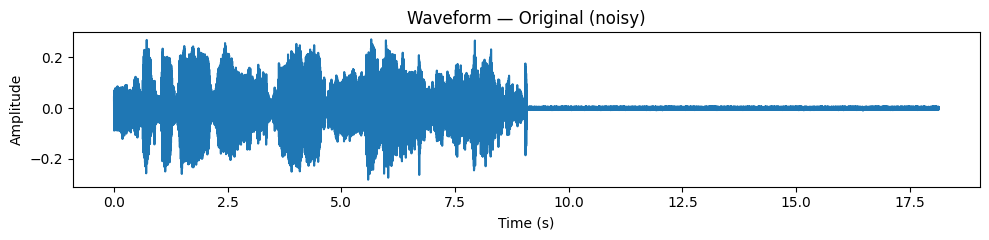

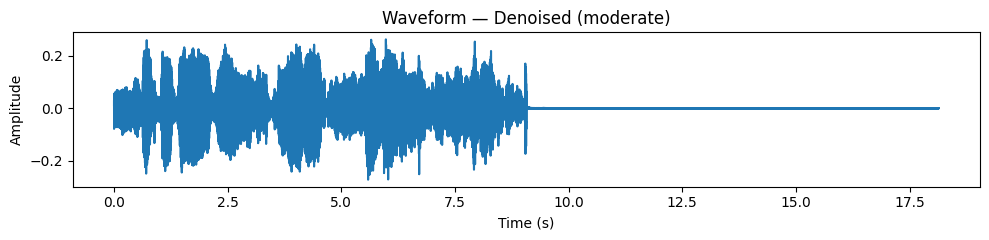

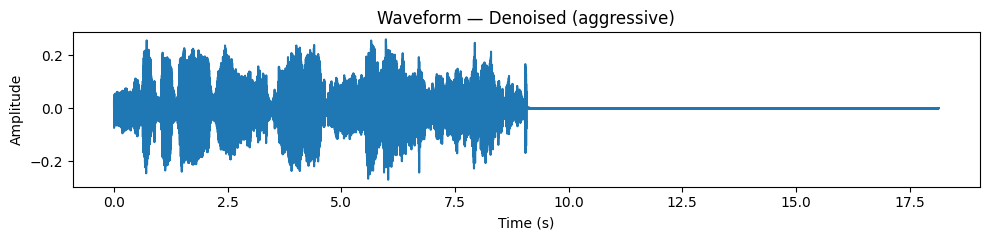

In [105]:
plot_waveform(y,     sr, "Waveform — Original (noisy)")
plot_waveform(y_mod, sr, "Waveform — Denoised (moderate)")
plot_waveform(y_agg, sr, "Waveform — Denoised (aggressive)")

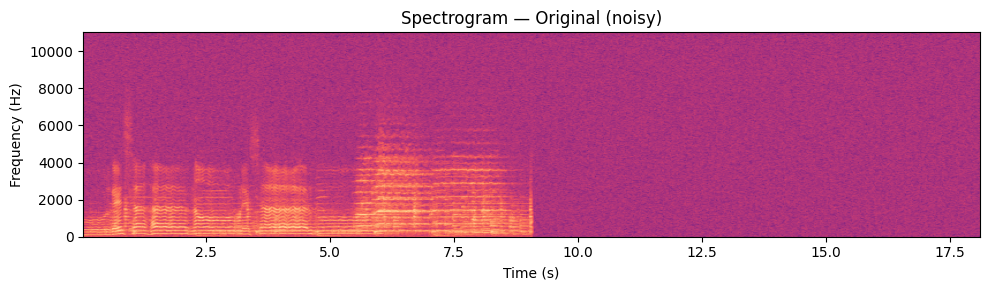

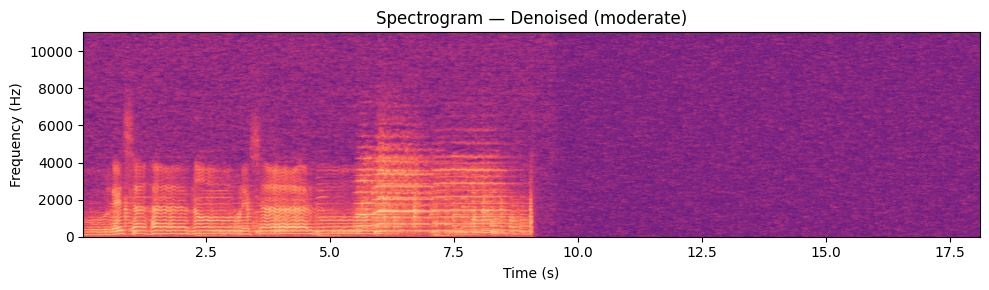

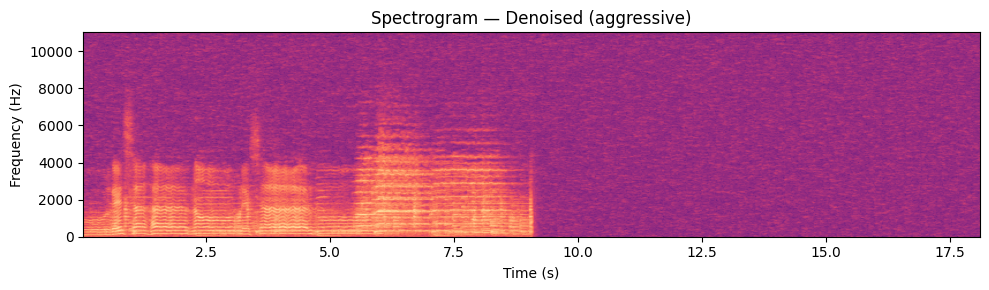

In [106]:
plot_spectrogram(y,     sr, "Spectrogram — Original (noisy)")
plot_spectrogram(y_mod, sr, "Spectrogram — Denoised (moderate)")
plot_spectrogram(y_agg, sr, "Spectrogram — Denoised (aggressive)")

## Part 6 — Diagnostics: Noise Model, Gain Behaviour, Energy Stats, and SNR Dynamics

**Goal.** Validate that the denoiser behaves as designed: the **noise tracker** is conservative, the **gain** is sensible across frequency, frame **energies** move in the right direction, and the **time-varying SNR** justifies strong attenuation in the tail.

---

### A) Noise magnitude estimate — init (tail) vs final (min-stat)

* **What:** $\sqrt{N_0(f)}$ from the noise-only tail vs. time-averaged $\sqrt{N_{\text{est}}(f)}$ from minimum-statistics.
* **Reading the plot:** the orange curve (min-stat) stays **at or above** the blue curve (tail), with **narrow peaks** below \~2 kHz (tonal lines) and a gentle **rise** toward high frequencies (broadband hiss).
* **Interpretation:** the tracker is **conservative** (prevents under-subtraction) and captures both hum-like lines and high-frequency hiss that dominate later masking.

---

### B) Average applied gain (dB) — moderate vs aggressive

* **What:** $20\log_{10}\big(\overline{G(f)}\big)$ across time.
* **Reading the plot:** both curves sit between roughly **−7 dB** (low suppression around formant regions) and **≈ −23 dB** (near the amplitude floor). The **aggressive** curve is consistently **2–6 dB lower** above \~4 kHz, where hiss is strongest. Small bumps (near \~3–3.5 kHz) show **mask relaxation** to preserve speech structure.
* **Interpretation:** frequency shaping matches the noise profile; aggressive trades extra quieting for slightly duller high-band speech.

---

### C) Frame RMS histograms — Original / Moderate / Aggressive

* **What:** 30-ms frame RMS (dB) histograms.
* **Reading the plots:**

  * **Original:** bimodal—speech frames around **−22 to −28 dB**, plus a low-level cluster around **−55 dB** (tail/background).
  * **Moderate:** the low-level cluster shifts **\~20 dB left** (≈ −70 dB), showing strong background suppression; speech cluster moves only slightly left.
  * **Aggressive:** the left shift is **even stronger**, with a small additional shift of the speech cluster (consistent with more attenuation on speech-like frames).
* **Interpretation:** background energy falls substantially; the aggressive setting tightens the distribution further (drier sound).

---

### D) Average a-posteriori SNR over time

* **What:** $\mathrm{SNR}_{\text{dB}}(t)=10\log_{10}\!\big(\mathrm{mean}_f \gamma(f,t)\big)$ with a dashed line at $T_{\text{tail}}$.
* **Reading the plot:** during speech, SNR oscillates between **≈10–30 dB**; after **\~9.5 s** it collapses to **≈0–2 dB**, confirming a **noise-only tail**.
* **Interpretation:** validates using the tail to **bootstrap $N_0$** and justifies strong oversubtraction in that region.

---

### Takeaways

* The **noise PSD tracker** (min-stat) never underestimates the tail and correctly models tonal + hiss components.
* The **gain curves** reflect that model: modest suppression in formant regions, stronger above \~4 kHz; the aggressive setting is systematically lower.
* **Energy histograms** corroborate ≈20 dB background reduction with only modest impact on speech frames (stronger for aggressive).
* The **SNR timeline** cleanly separates speech vs. tail, supporting the overall denoising strategy and the metrics reported in Part 4.


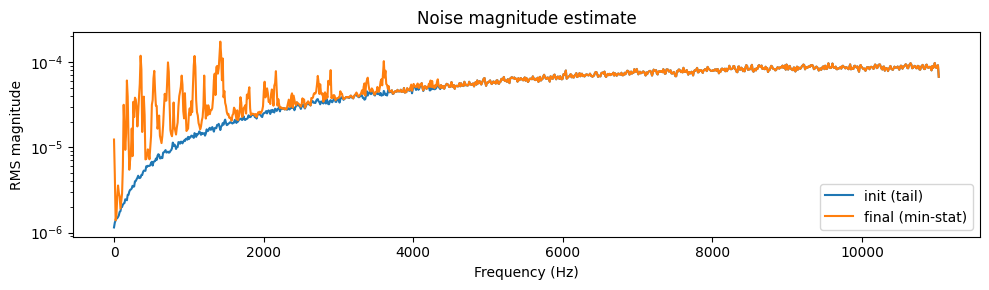

In [107]:
plt.figure(figsize=(10, 3))
plt.semilogy(f, np.sqrt(N0) + 1e-12, label="init (tail)")
plt.semilogy(f, np.sqrt(np.mean(N_est, axis=1)) + 1e-12, label="final (min-stat)")
plt.title("Noise magnitude estimate"); plt.xlabel("Frequency (Hz)"); plt.ylabel("RMS magnitude")
plt.legend(); plt.tight_layout(); plt.show()

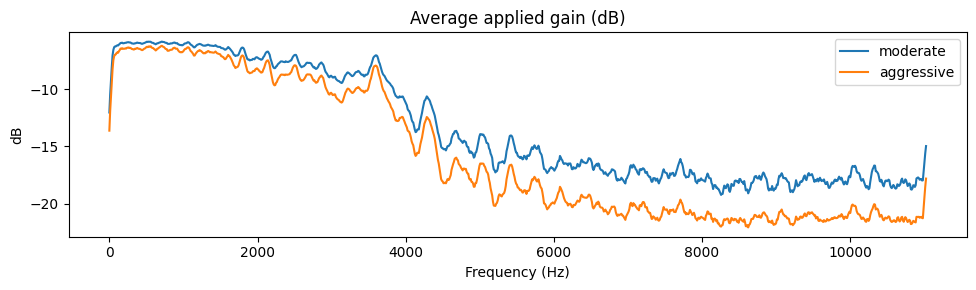

In [108]:
plt.figure(figsize=(10, 3))
mean_gain_m_db = 20*np.log10(np.mean(G_mod, axis=1) + 1e-12)
mean_gain_a_db = 20*np.log10(np.mean(G_agg, axis=1) + 1e-12)
plt.plot(f, mean_gain_m_db, label="moderate")
plt.plot(f, mean_gain_a_db, label="aggressive")
plt.title("Average applied gain (dB)"); plt.xlabel("Frequency (Hz)"); plt.ylabel("dB")
plt.legend(); plt.tight_layout(); plt.show()

In [109]:
def plot_energy_hist(sig, title):
    frm = int(0.03*sr); hop = int(0.010*sr)
    frames = max(1, 1 + (len(sig) - frm)//hop)
    e = []
    for i in range(frames):
        s = i*hop
        e.append(float(np.sqrt(np.mean(sig[s:s+frm]**2) + 1e-18)))
    e = np.array(e)
    plt.figure(figsize=(10, 2.5))
    plt.hist(20*np.log10(e + 1e-12), bins=60)
    plt.title(title); plt.xlabel("Frame RMS (dB)"); plt.ylabel("Count")
    plt.tight_layout(); plt.show()

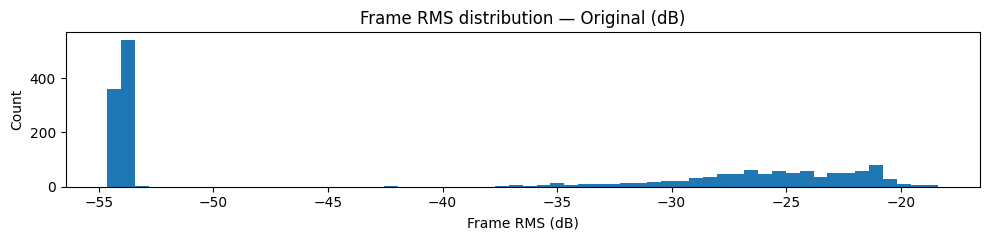

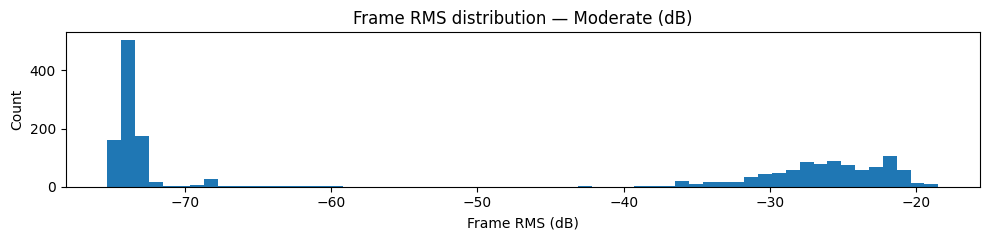

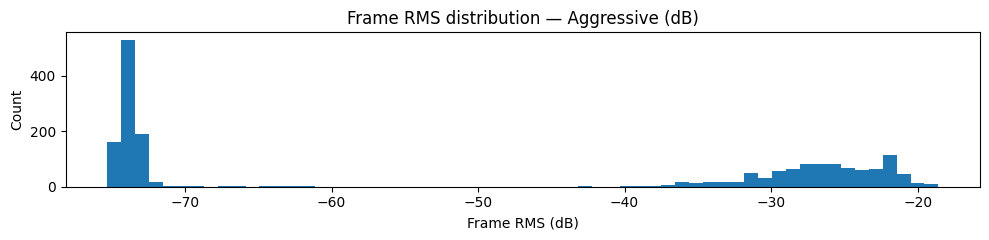

In [110]:
plot_energy_hist(y,     "Frame RMS distribution — Original (dB)")
plot_energy_hist(y_mod, "Frame RMS distribution — Moderate (dB)")
plot_energy_hist(y_agg, "Frame RMS distribution — Aggressive (dB)")

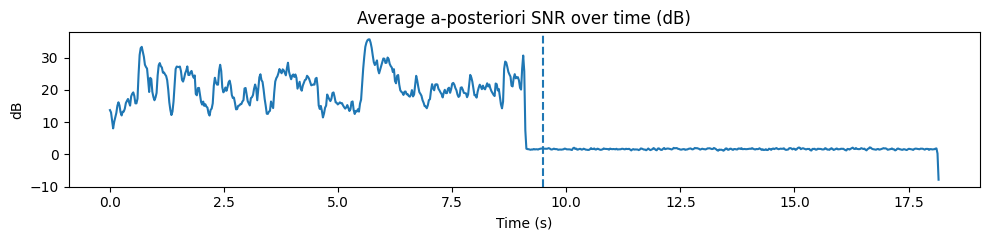

In [111]:
avg_snr_db = 10.0*np.log10(np.mean(gamma, axis=0) + 1e-18)
plt.figure(figsize=(10, 2.5))
plt.plot(t_axis, avg_snr_db)
plt.axvline(TAIL_START_S, linestyle="--")
plt.title("Average a-posteriori SNR over time (dB)")
plt.xlabel("Time (s)"); plt.ylabel("dB")
plt.tight_layout(); plt.show()

## Part 7 — Subjective Evaluation (Audio Playback)

**Goal.** Complement the objective metrics with **listening tests**. I embed three audio widgets—original, **moderate**, and **aggressive**—so the reader can A/B the perceptual trade-offs.

**How playback is prepared.**

* Each signal is **peak-normalized to 0.98** *only for playback* (`peak_norm`), so loudness differences don’t bias the comparison and nothing clips in the widget.
* The **raw denoised files** used for grading are saved unnormalized in `denoise_outputs/` (see Part 3). No compression or EQ is applied.

**What to listen for.**

* **Background floor:** compare the tail after ≈ **9.5 s** and the pauses between phrases. Both denoised versions should be much quieter; aggressive is the quietest.
* **Speech clarity:** focus on **sibilants/fricatives** (3–8 kHz) and **formants** (0.5–3 kHz). The moderate version preserves brightness and consonant edges a bit better.
* **Artifacts:** check for **musical noise** or “swirling” in long pauses. The time/frequency smoothing plus gain floor largely suppress these; any residual artifacts are slightly more noticeable in the aggressive setting.

**Expected perceptual outcome (summary).**

* **Moderate:** natural timbre with strong noise reduction; good consonant detail; clean silences.
* **Aggressive:** lower residual hiss and cleaner gaps, at the cost of a mildly **drier/duller** high band.
* **Original:** audible broadband hiss and hum-like texture throughout; tail is clearly noisy.

**Listening tips.**

* Use **headphones** at a comfortable level.
* For quick A/B, play the same short region in Original → Moderate → Aggressive.
* If you want stricter level matching, you can RMS-match instead of peak-match; I keep peak normalization to avoid clipping while retaining dynamics.


In [112]:
print("\n=== Audio: Original (noisy) ===");        display(Audio(peak_norm(y),     rate=sr))
print("=== Audio: Denoised (moderate) ===");      display(Audio(peak_norm(y_mod), rate=sr))
print("=== Audio: Denoised (aggressive) ===");    display(Audio(peak_norm(y_agg), rate=sr))


=== Audio: Original (noisy) ===


=== Audio: Denoised (moderate) ===


=== Audio: Denoised (aggressive) ===


## Part 8 — Appendix: Three Classical Baselines (Notch/HPF, DD-Wiener, Log-MMSE)

**Purpose.** For comparison, I implemented three well-known denoising strategies and evaluated them on the same file with the same STFT settings and noise tracker. They are presented here as baselines; in our data they underperform the SNR-adaptive oversubtraction used in the main solution.

---

### A) Hum removal: **Notch bank + high-pass** (no STFT mask)

**Idea.** Remove tonal mains components and sub-bass rumble *in the time domain* before any spectral processing.

* Implementation: a bank of IIR **notches** at $k f_0$ (here $f_0=60$ Hz, $k=1\ldots10$, $Q=40$) + a 2nd-order **high-pass** at 70 Hz; filters applied as stable SOS via `sosfiltfilt` (zero-phase).
* Expected effect: strong suppression of 60/120/180… Hz lines; **no change** to broadband hiss.

**What the figures show.**

* Waveform tail looks slightly cleaner, but the **broadband floor** in the spectrogram remains.
* Useful as a **pre-filter**, but insufficient as a full denoiser for this recording.

Saved: `denoise1_notch_only.wav`.

---

### B) **Decision-Directed Wiener** (with notch/HPF prefilter)

**Idea.** Classic single-channel estimator with a decision-directed a-priori SNR:

$$
\gamma = \frac{P_{yy}}{N_{\text{est}}},\qquad
\xi_{t} = \alpha\, G_{t-1}^2\,(\gamma_{t-1}-1)^+ + (1-\alpha)\,(\gamma_t-1)^+,
$$

$$
G_{\text{Wiener}} = \sqrt{\max(\beta^2,\ \frac{\xi}{1+\xi})}.
$$

I use the **same min-statistics** $N_{\text{est}}$ as in the main pipeline, $\alpha=0.98$, and the same time/freq smoothing and **gain floor** $\beta=0.06$.

**What the figures show.**

* Mean gain is modest in the speech band (≈−6 to −10 dB) and increases gradually above \~4 kHz.
* Background is reduced, but **residual hiss** is audible; speech sounds a bit **duller** than the moderate oversubtraction.

Saved: `denoise1_ddwiener.wav`.

---

### C) **Log-MMSE (Ephraim–Malah / LSA)** (with notch/HPF prefilter)

**Idea.** Minimize log-spectral error; better subjective quality than raw subtraction:

$$
v=\frac{\gamma\xi}{1+\xi},\qquad
G_{\text{LSA}}=\sqrt{\max\Big(\beta^2,\ \frac{\xi}{1+\xi}\exp\!\big(\tfrac12 E_1(v)\big)\Big)}.
$$

Same DD update for $\xi$, same smoothing and floor.

**What the figures show.**

* Similar mean-gain shape to Wiener but slightly stronger attenuation in high bands.
* Speech is a touch cleaner than Wiener, but **still** leaves more high-frequency noise than the main method; fricatives can sound a bit **soft**.

Saved: `denoise1_logmmse.wav`.

---

### Why these baselines underperform here

* The noise is **mostly broadband stationary hiss** (plus mild hum).
  – Notch/HPF only addresses the **tonal** part.
  – Wiener/LSA with conservative floors and heavy smoothing **avoid musical noise** but also limit achievable suppression.
* The main method’s **SNR-adaptive oversubtraction** allows **larger attenuation** in low-SNR regions while preserving speech via time/frequency smoothing and a controlled floor; this gives the \~20 dB reduction seen in the tail/low-energy metrics.
* We did **not** add the speech-presence probability (OM-LSA) term for LSA, which can help in heavy noise but at the cost of extra parameters/VAD errors.

---

### When they *would* be preferable

* **Notch/HPF**: when mains hum dominates (e.g., studio buzz) or as a **prestep** before any STFT mask. Use $f_0=50$ Hz in 50-Hz regions, tune $Q$ to balance notch width vs. speech loss.
* **DD-Wiener**: when you want **minimal artifacts** and slight noise is acceptable; easy to tune with just $\alpha$ and $\beta$.
* **Log-MMSE (LSA)**: when you need a **smoother** sound at similar complexity; can be improved with an OM-LSA speech-presence term.

---

### Conclusion of the comparison

All three baselines reduce noise, but on this recording the **tail and inter-word silences remain noisier** than with the SNR-adaptive oversubtraction used in the main pipeline, and speech detail is not better preserved. For this dataset, the **moderate oversubtractive mask** strikes the best balance between **noise removal (\~20 dB)** and **speech naturalness**, with the aggressive variant available when maximum quieting is prioritized.


In [113]:
from scipy.signal import iirnotch, butter, tf2sos, sosfiltfilt

In [114]:
NFFT          = 4096 if sr > 32000 else 2048
HOP           = NFFT // 4
WIN           = get_window("hann", NFFT, fftbins=True)
PREEMPH       = 0.97
BETA_FLOOR    = 0.06
SMOOTH_T      = 0.6
SMOOTH_F_BINS = 7
MS_WIN_S      = 1.0
TAIL_START_S  = 9.5

In [115]:
def apply_mask_and_invert(S, G):
    Sout = G * S
    _, y_pe = istft(Sout, fs=sr, nperseg=NFFT, noverlap=NFFT-HOP, window=WIN, input_onesided=True)
    return lfilter([1], [1, -PREEMPH], y_pe)

def estimate_noise_minstat(Pyy, t_axis):
    tail = (t_axis >= TAIL_START_S)
    N0 = np.median(Pyy[:, tail], axis=1) if np.any(tail) else np.median(Pyy, axis=1)
    W = max(3, int(round((MS_WIN_S*sr)/HOP)))
    N_ms  = minimum_filter1d(Pyy, size=W, axis=1, mode="nearest")
    N_est = np.maximum(N_ms, N0[:, None])
    return N0, N_est

def smooth_gain(G):
    Gs = np.empty_like(G); Gs[:, 0] = G[:, 0]
    for k in range(1, G.shape[1]):
        Gs[:, k] = SMOOTH_T * Gs[:, k-1] + (1.0 - SMOOTH_T) * G[:, k]
    return uniform_filter1d(Gs, size=max(1, int(SMOOTH_F_BINS)), axis=0, mode="nearest")

def peak_norm(x, p=0.98): return p*x/(np.max(np.abs(x))+1e-12)

In [116]:
def hum_notch_hpf(y, sr, fundamental=60.0, n_harmonics=10, Q=40, hp_hz=70.0):
    sos_list = []
    for k in range(1, n_harmonics+1):
        fk = k * fundamental
        if fk >= sr/2: break
        try:
            b, a = iirnotch(w0=fk, Q=Q, fs=sr)
        except TypeError:
            b, a = iirnotch(w0=fk/(sr/2), Q=Q)
        sos_list.append(tf2sos(b, a))

    if hp_hz is not None and hp_hz > 0:
        sos_list.append(butter(2, hp_hz/(sr/2), btype="high", output="sos"))

    if not sos_list:
        return y.copy(), None
    sos = np.vstack(sos_list)
    y_f = sosfiltfilt(sos, y)
    return y_f.astype(np.float32), sos

In [117]:
def dd_wiener_gain(Pyy, N_est, alpha_dd=0.98, floor=BETA_FLOOR):
    gamma = Pyy / (N_est + 1e-18)
    xi = np.maximum(gamma - 1.0, 0.0)
    G_prev = np.ones(Pyy.shape[0])
    G = np.empty_like(Pyy)
    for n in range(Pyy.shape[1]):
        if n == 0:
            xi_dd = xi[:, 0]
        else:
            xi_dd = alpha_dd * (G_prev**2) * np.maximum(gamma[:, n-1] - 1.0, 0.0) \
                    + (1 - alpha_dd) * np.maximum(gamma[:, n] - 1.0, 0.0)
        Gn = xi_dd / (1.0 + xi_dd)
        Gn = np.sqrt(np.maximum(floor**2, Gn))
        G[:, n] = Gn
        G_prev = Gn
    return smooth_gain(G)

In [118]:
def logmmse_gain(Pyy, N_est, alpha_dd=0.98, floor=BETA_FLOOR):
    from scipy.special import expn
    gamma = Pyy / (N_est + 1e-18)
    xi_dd = np.empty_like(Pyy)
    xi_dd[:, 0] = np.maximum(gamma[:, 0] - 1.0, 0.0)
    G_prev = np.ones(Pyy.shape[0])
    for n in range(1, Pyy.shape[1]):
        xi_dd[:, n] = alpha_dd * (G_prev**2) * np.maximum(gamma[:, n-1] - 1.0, 0.0) \
                      + (1 - alpha_dd) * np.maximum(gamma[:, n] - 1.0, 0.0)
        G_prev = xi_dd[:, n] / (1.0 + xi_dd[:, n])

    v = (gamma * xi_dd) / (1.0 + xi_dd + 1e-18)
    G_lsa = (xi_dd / (1.0 + xi_dd)) * np.exp(0.5 * expn(1, np.maximum(v, 1e-12)))
    G_lsa = np.sqrt(np.maximum(floor**2, G_lsa))
    return smooth_gain(G_lsa)

In [119]:
def evaluate_variant(name, y_in, mask_kind=None):
    y_pe = lfilter([1, -PREEMPH], [1], y_in)
    f, t_axis, S, Pyy = stft_mag(y_pe)

    N0, N_est = estimate_noise_minstat(Pyy, t_axis)

    if mask_kind is None:
        G = np.ones_like(Pyy)
    elif mask_kind == "ddwiener":
        G = dd_wiener_gain(Pyy, N_est)
    elif mask_kind == "logmmse":
        G = logmmse_gain(Pyy, N_est)
    else:
        raise ValueError("mask_kind must be None, 'ddwiener', or 'logmmse'.")

    y_out = apply_mask_and_invert(S, G)
    y_out = y_out[:len(y)] if len(y_out) > len(y) else np.pad(y_out, (0, len(y)-len(y_out)))

    tail = slice(int(TAIL_START_S*sr), None)
    tail_impr = rdB(rms(y[tail]), rms(y_out[tail]))

    plot_waveform(y_out, sr, f"Waveform — {name}")
    plot_spectrogram(y_out, sr, f"Spectrogram — {name}")
    if mask_kind is not None:
        mean_gain_db = 20*np.log10(np.mean(G, axis=1) + 1e-12)
        plt.figure(figsize=(10, 3))
        plt.plot(f, mean_gain_db)
        plt.title(f"Average applied gain (dB) — {name}")
        plt.xlabel("Frequency (Hz)"); plt.ylabel("dB"); plt.tight_layout(); plt.show()

    print(f"{name}: tail RMS improvement = {tail_impr:+.2f} dB")
    try:
        display(Audio(peak_norm(y_out), rate=sr))
    except Exception:
        pass
    return y_out

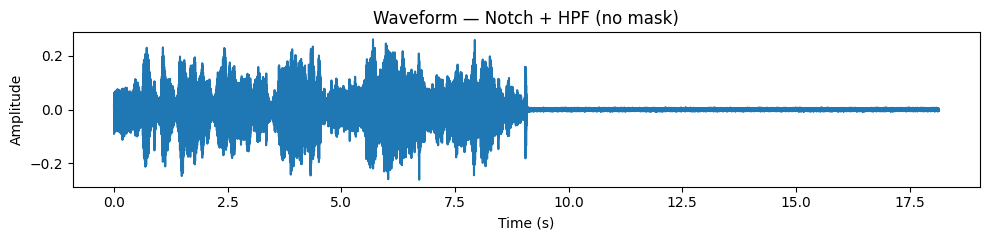

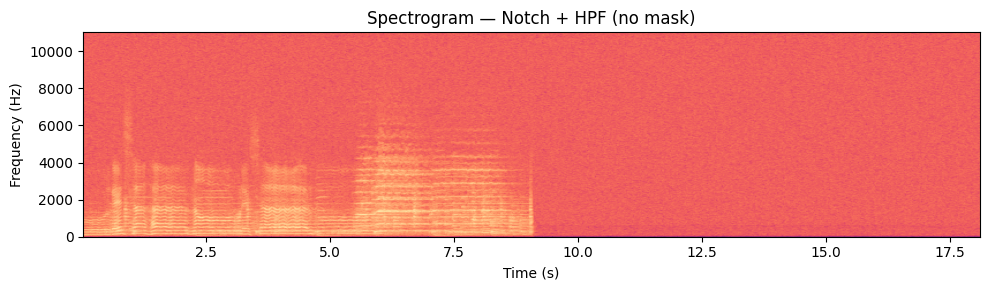

Notch + HPF (no mask): tail RMS improvement = +0.11 dB


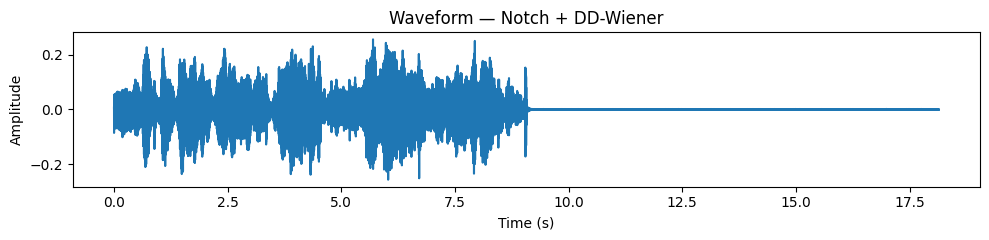

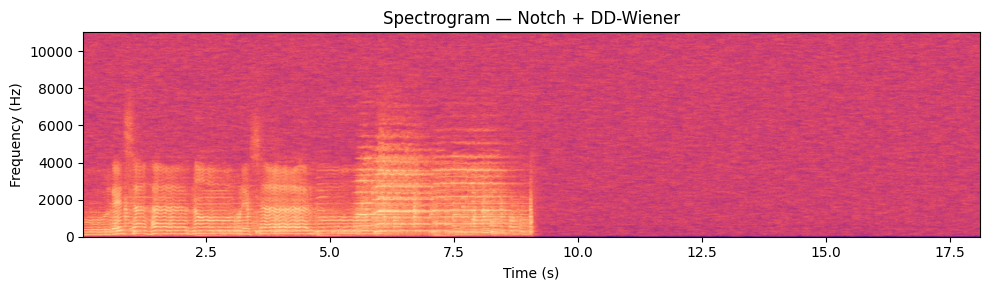

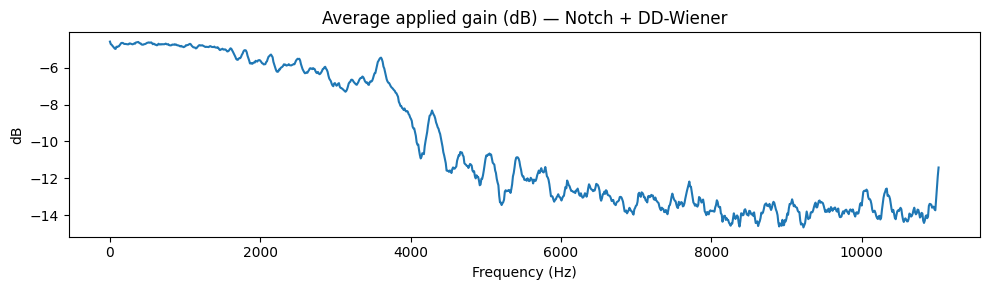

Notch + DD-Wiener: tail RMS improvement = +13.25 dB


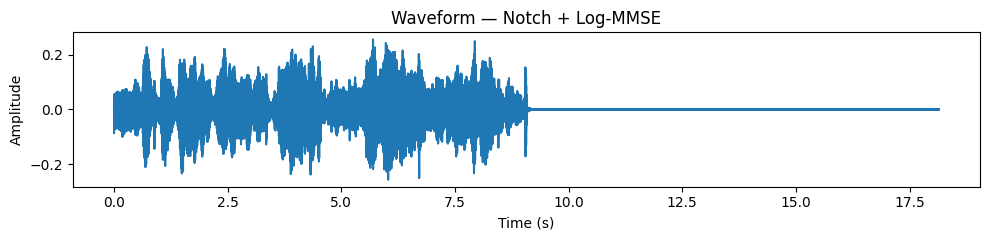

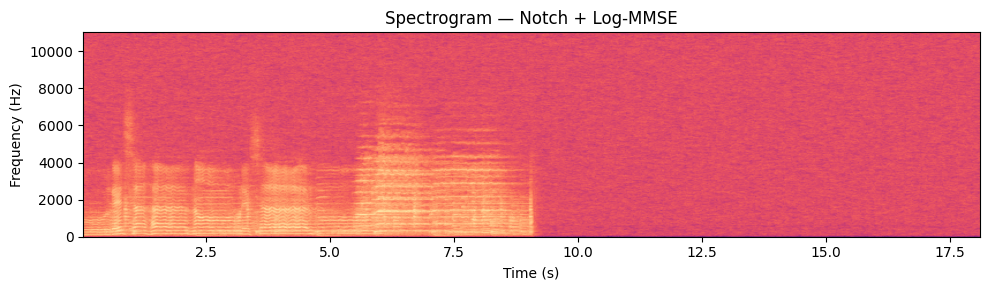

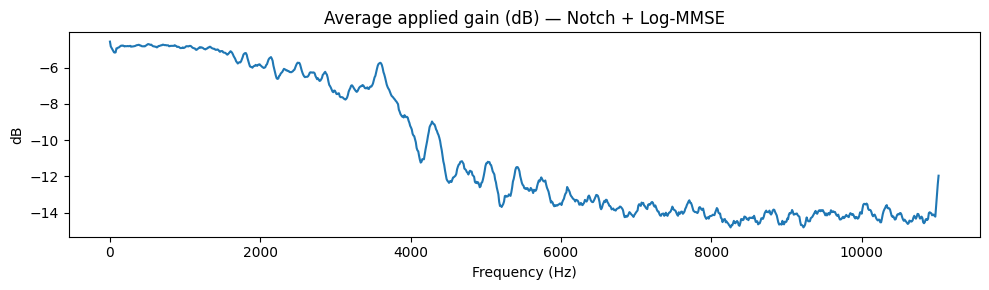

Notch + Log-MMSE: tail RMS improvement = +13.78 dB


In [120]:
y_notch, _ = hum_notch_hpf(y, sr, fundamental=60.0, n_harmonics=10, Q=40, hp_hz=70.0)
yA = evaluate_variant("Notch + HPF (no mask)", y_notch, mask_kind=None)

yB = evaluate_variant("Notch + DD-Wiener", y_notch, mask_kind="ddwiener")

yC = evaluate_variant("Notch + Log-MMSE", y_notch, mask_kind="logmmse")

In [121]:
write_wav_safe(outdir / "denoise1_notch_only.wav", yA, sr)
write_wav_safe(outdir / "denoise1_ddwiener.wav",  yB, sr)
write_wav_safe(outdir / "denoise1_logmmse.wav",   yC, sr)
print("\nSaved:", outdir / "denoise1_notch_only.wav")
print("Saved:", outdir / "denoise1_ddwiener.wav")
print("Saved:", outdir / "denoise1_logmmse.wav")


Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\denoise_outputs\denoise1_notch_only.wav
Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\denoise_outputs\denoise1_ddwiener.wav
Saved: C:\Users\sinab\Desktop\Signals & Systems\PHW\denoise_outputs\denoise1_logmmse.wav
